<a href="https://colab.research.google.com/github/shreyasmiraj/feature_attention_EEG/blob/main/EEG_Feature_Attention.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

##Install required packages

In [ ]:
!pip install mne
!pip install CFsshTunnel

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 7.6/7.6 MB 44.6 MB/s eta 0:00:00
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!apt-get install git-annex
!apt-get install datalad

##ssh-codeserver

In [ ]:
from getpass import getpass
from CFsshTunnel.CFsshTunnel import CFsshTunnel
from CFsshTunnel.utils.utils import keep_alive
from CFsshTunnel.code_server.code_server import launch_codeserver

_, hostname, user = CFsshTunnel()
launch_codeserver(user=user, hostname=hostname)

Checking for openssh-server
Installing openssh-server through apt-get
Checking for cloudflared
Installing cloudflared
authorized ssh-rsa pub auth keys sep by newline:··········


+---------------------------------------------------+
| open_ssh_cloudflare tunnel route is now alive at: |
| picked-laid-enable-scratch.trycloudflare.com      |
+---------------------------------------------------+


Update ~/.ssh/config on client as below:

#Client ~/.ssh/config
#-------------------------------------------------
Host picked-laid-enable-scratch.trycloudflare.com
	Hostname %h
	User root
	Port 53543
	LogLevel ERROR
	UserKnownHostsFile /dev/null
	ProxyCommand cloudflared access ssh --hostname %h
#-------------------------------------------------
Note: Windows client users on PS/cmd, provide full path to cloudflared.exe in ProxyCommand
        Also applies to linux users if PATH to cloudflared isn't added to $PATH
        Ex: Instead of 
            `ProxyCommand cloudflared access ssh --hostname

##Mount google drive

In [ ]:
from google.colab import drive

drive.mount('/content/drive')

Mounted at /content/drive


##Imports packages

In [ ]:
import os
import subprocess
import math
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import mne
import scipy
import pickle
from tqdm.notebook import tqdm

##Helper functions

In [ ]:
def save_pickle(file_path, var):
  """
    Saves python object to specified file path using pickle
    Inputs:
      file_path(str):path to file to store the object into
      var(object like):any python object
  """
  with open(file_path,"wb") as f:
    pickle.dump(var, f, pickle.HIGHEST_PROTOCOL)

def load_pickle(file_path):
  """
    Loads python object from specified file path using pickle
    Inputs:
      file_path(str):path to file to load the object from
  """
  with open(file_path,"rb") as f:
    return pickle.load(f)

def vprint(info, verbose=True):
  if verbose:
    print('    '+'|'+'_'*4+info)

##Set Config

In [ ]:
!MNE_USE_CUDA=true python -c "import mne; mne.cuda.init_cuda(verbose=True)"
mne.set_config('MNE_USE_CUDA', 'true')
mne.set_config('MNE_BROWSE_RAW_SIZE','80,40') 

plt.rcParams.update({'figure.max_open_warning': 0})

Now using CUDA device 0
Enabling CUDA with 14.62 GB available memory
Attempting to create new mne-python configuration file:
/root/.mne/mne-python.json


##Set Paths

In [ ]:
drive_data_path = '/content/drive/MyDrive/NBRC/EEG/EEG_Attention/data/'
drive_output_path = '/content/drive/MyDrive/NBRC/EEG/EEG_Attention/data/results/'

##Hypothesis
We suspect there to be differential activity in the dorsal(orientation sensitive) and ventral visual stream(color sensitive) when comparing the target and foil stimuli activity, since in the foil stimuli a mismatch occurs in processing and there is conflict between top down processing and bottom up processing.

##Download data

Reference paper: https://www.nature.com/articles/s41598-022-10687-x

 run in terminal
```
datalad install https://github.com/OpenNeuroDatasets/ds004043.git

cd /root/eeg_data/ds004043

datalad get sub-*/eeg/*
```

##Batch preprocessing

In [ ]:
def batch_process_subjects(data_path, output_path, ids=[], bad_channels={}, interpolate_bads=True, drop_bads=False, show_state=False, verbose=True, plot_state=True):
  """ Run batch process for the set of subjects passed and plot intermediates till epoching and ERP

  Parameters:
  -----------

    data_path : str | path_like
      path to raw data
    output_path : str | path_like
      path to output
    ids : List(int)
      subject id list in the form of integer array
      ex: ids=[1,2,3,4] or ids=range(1,21)
    bad_channels : dict
      dict with keys as subject_id and list of associated bad channel names in the form List(str) as its value
      ex: bad_channels = {'sub-20':['FP1','Cz'],'sub-02':['TP1']}
    interpolate_bads : bool
      set to True inorder to interpolate bad channels and remove them from bads
    drop_bads : bool
      set to True inorder to drop bad channels from the data while processing
    show_state : bool
      set to True to show plot while processing
      Note: needs plot_state to be set to True inorder to function
    verbose : bool
      set to False to run quitely (no messages display)
    plot_state : bool
      set to True to enable generation of plots. They are saved in the output directory
      Note: in order to display while processing set show_state.
  """
  if not os.path.exists(output_path):
    os.mkdir(output_path)
  
  subject_ids = []
  if len(ids) == 0:
    ids = range(1,21)
  for id in ids:
    if id < 10:
      subject_ids.append('sub-'+'0'+str(id))
    else:
      subject_ids.append('sub-'+str(id))

  for subject_id in tqdm(subject_ids):
    print('='*8+'>Processing subject_ID: ', subject_id)
    
    output_dir = subject_id
    output_dir_path = os.path.join(output_path, output_dir)
    
    if os.path.exists(output_dir_path):
      os.system('rm -rf '+output_dir_path)
    os.mkdir(output_dir_path)
    
    vprint('Reading data from file', verbose=verbose)
    #Read and import data through .vhdr header file
    raw_data = mne.io.read_raw_brainvision(os.path.join(data_path,subject_id,'eeg',subject_id +'_task-tempex_eeg.vhdr'), verbose=False)
    n_interpolated = 0
    if len(bad_channels) != 0:
      bad_channel_subjects = list(bad_channels.keys())
      if subject_id in bad_channel_subjects:
        raw_data.info['bads'].extend(bad_channels[subject_id])
        if interpolate_bads:
          vprint('Interpolating bad channels', verbose=verbose)
          raw_data.load_data(verbose=False)
          raw_data.interpolate_bads(reset_bads=True, verbose=False)
          n_interpolated = len(bad_channels[subject_id])
        elif drop_bads:
          vprint('Dropping bad channels', verbose=verbose)
          raw_data.drop_channels(bad_channels[subject_id])
      
    N_CHANNELS = len(raw_data.info.ch_names)
    eeg_picks =  mne.pick_types(raw_data.info, eeg=True)
    
    vprint('Extracting events and cropping', verbose=verbose)
    #extract events and set start time from first trigger and crop data accordingly
    events, events_dict = mne.events_from_annotations(raw_data, verbose=False)
    tmin = math.floor(events[1][0]/1000)
    raw_data.load_data(verbose=False)

    #Crop data and reset event time points
    # raw_data.crop(tmin=tmin, verbose=False)
    # for event in events:
    #   event[0] = event[0]-tmin*1000
    # events[0][0] = 0
    # raw_data.load_data(verbose=False)
    # tmin = events[1][0]/1000
    # tmax = events[-1][0]/1000
    # total_duration = tmax-tmin  #in seconds
    
    vprint('Generating sensor location', verbose=verbose)
    #generate sensor location plots
    if plot_state:
      fig = raw_data.plot_sensors(kind='topomap', ch_type='all', show_names=True, show=show_state);
      fig.savefig(os.path.join(output_dir_path,'sensor_location'))
      plt.close('all')
      del fig
    
    vprint('Average re-referencing data', verbose=verbose)
    avg_ref_data = raw_data.copy()
    avg_ref_data.load_data(verbose=False)
    avg_ref_data.set_eeg_reference(ref_channels='average',verbose=False)
    del raw_data

    # if plot_state:
    #   fig = avg_ref_data.plot(events=events,start=0,n_channels=63,remove_dc=True,show=show_state, verbose=False);
    #   fig.savefig(os.path.join(output_dir_path,'average_rereferenced_timeseries'))
    #   plt.close('all')
    #   del fig
    
    plt.close('all')

    vprint('Filtering data', verbose=verbose)
    #filtering data
    filtered_data = avg_ref_data.copy()
    filtered_data.load_data(verbose=False)
    filtered_data.filter(l_freq=0.1, h_freq=100, verbose=False, n_jobs='cuda')
    del avg_ref_data
    notch_filtered_data = filtered_data.copy()
    notch_filtered_data.load_data(verbose=False)
    notch_filtered_data.notch_filter(freqs=[50,100],picks=eeg_picks, verbose=False, n_jobs='cuda')
    del filtered_data

    vprint('Generating PSD and timeseries plots', verbose=verbose)
    #generate raw psd, psd_topomap and timeseries plot
    if plot_state:
      fig = notch_filtered_data.plot_psd(fmax=60, picks=notch_filtered_data.ch_names[:], verbose=False)
      # psd = raw_data.compute_psd(fmax=60, picks=raw_data.ch_names[:], method='welch', verbose=False)
      # fig = psd.plot(show=show_state);
      fig.savefig(os.path.join(output_dir_path,'raw_topo'))
      plt.close('all')
      del fig
      # fig = raw_data.plot(start=0, duration=200, n_channels=N_CHANNELS, remove_dc=True, show=show_state);
      # fig.savefig(os.path.join(output_dir_path,'raw_timeseries'))
      # plt.clf()

    vprint('Epoching data', verbose=verbose)
    #load data for ICA and other following steps
    event_ID = 10001 #E 1
    epoch_tmin = -0.1 #-100ms
    epoch_tmax = 0.8  #800ms
    epochs = mne.Epochs(notch_filtered_data, events, event_ID, epoch_tmin, epoch_tmax, baseline=None, detrend=1, preload=False, verbose=False)
    del notch_filtered_data
    vprint('Resampling data', verbose=verbose)
    #resample the data
    epochs.load_data()
    epochs.resample(sfreq=250, verbose=False)


    vprint('Applying ICA', verbose=verbose)
    #apply ICA
    ica_channels = N_CHANNELS-n_interpolated-1
    ica = mne.preprocessing.ICA(n_components=ica_channels, max_iter='auto',random_state=42,verbose=False)
    ica.fit(epochs, verbose=False)
    
    print(' '*4 +'|'+'_'*4+'ICA_Explained variance: ',ica.get_explained_variance_ratio(epochs,components=range(ica_channels),ch_type='eeg')['eeg'])

    vprint('Generating ICA componenet plots', verbose=verbose)
    if plot_state:
      ica_plot_dir = os.path.join(output_dir_path,'ica_plots')
      if os.path.exists(ica_plot_dir):
        os.system("rm -rf "+str(ica_plot_dir))
      os.mkdir(ica_plot_dir)
      
      figs = ica.plot_components(show=show_state, verbose=False);
      ica_ID = 0
      for fig in figs: 
        fig.savefig(os.path.join(ica_plot_dir, 'topo_ica'+str(ica_ID)))
        ica_ID += 1
      del figs
      plt.close('all')
      
      figs = ica.plot_properties(epochs, picks=range(ica_channels), verbose=False, show=show_state);
      ica_ID = 0
      for fig in figs:
        fig.savefig(os.path.join(ica_plot_dir,'prop_ica_'+str(ica_ID)))
        ica_ID += 1
      del figs
      plt.close('all')

    vprint('Finding eye and muscle artifact components', verbose=verbose)
    ica.exclude = []
    eog_indices, eog_scores = ica.find_bads_eog(epochs, ch_name=['Fp1','Fp2'], verbose=False)
    print(' '*7+'-'*2+'eog_indices', eog_indices)
    muscle_indices, scores = ica.find_bads_muscle(epochs, verbose=False)
    print(' '*7+'-'*2+'muscle_indices', muscle_indices)
    # ica.plot_scores(scores, exclude=muscle_indices);
    # ica.plot_properties(notch_filtered_data, picks=muscle_indices, topomap_args={'sphere':sphere_info}, verbose=False);
    ica.exclude.extend(eog_indices)
    ica.exclude.extend(muscle_indices)
    #save ICA weights
    save_pickle(os.path.join(output_dir_path,'fast_ICA'),ica)
    save_pickle(os.path.join(output_dir_path,'epoched_data'),epochs)

    vprint('Reconstructing data', verbose=verbose)
    #reconstruct ICA with the selected ICA components
    ica.apply(epochs, verbose=False)
    epochs.apply_baseline(baseline=(None,None), verbose=False)
    
    # vprint('Generating reconstructed data plot', verbose=verbose)
    # if plot_state:
    #   fig = epochs.plot(n_epochs=100,show=show_state);
    #   fig.savefig(os.path.join(output_dir_path,'epoch_detrend_timeseries'))
    #   plt.clf()
    #   del fig

    vprint('Computing and plotting avg ERP', verbose=verbose)
    # ERP for the target stimuli
    epochs_average = epochs.average()
    del epochs

    if plot_state:
      fig = epochs_average.plot_joint(times='peaks',show=show_state);
      fig.savefig(os.path.join(output_dir_path,'ERP_target'))
      plt.clf()
      del fig

    # save_pickle(os.path.join(output_dir_path,'epoched_data'), reconstructed_data)
    del epochs_average
    plt.close('all')
    print('\n')

In [ ]:
batch_process_subjects(drive_data_path, drive_output_path, ids=range(17,21),plot_state=True)

  0%|          | 0/4 [00:00<?, ?it/s]

========>Processing subject_ID:  sub-17
    |____Reading data from file
    |____Extracting events and cropping
    |____Generating sensor location
    |____Average re-referencing data
    |____Filtering data
    |____Generating PSD and timeseries plots
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
    |____Epoching data
    |____Resampling data
Using data from preloaded Raw for 8704 events and 901 original time points ...
0 bad epochs dropped
    |____Applying ICA


/usr/local/lib/python3.9/dist-packages/sklearn/decomposition/_fastica.py:123: ConvergenceWarning: FastICA did not converge. Consider increasing tolerance or the maximum number of iterations.
  warnings.warn(


    |____ICA_Explained variance:  1.0
    |____Generating ICA componenet plots
    |____Finding eye and muscle artifact components
       --eog_indices [0, 8, 18]
       --muscle_indices [1, 4, 6, 8, 9, 10, 11, 12, 13, 14, 16, 17, 18, 19, 20, 22, 23, 24, 26, 27, 28, 29, 30, 32, 33, 34, 36, 37, 42, 45, 46, 48, 57, 59, 60, 61]
    |____Reconstructing data
    |____Computing and plotting avg ERP
No projector specified for this dataset. Please consider the method self.add_proj.


========>Processing subject_ID:  sub-18
    |____Reading data from file
    |____Extracting events and cropping
    |____Generating sensor location
    |____Average re-referencing data
    |____Filtering data
    |____Generating PSD and timeseries plots
NOTE: plot_psd() is a legacy function. New code should use .compute_psd().plot().
    |____Epoching data
    |____Resampling data
Using data from preloaded Raw for 8704 events and 901 original time points ...
0 bad epochs dropped
    |____Applying ICA
    |____ICA_

#Batch analysis

In [ ]:
def individual_ERP(target_evoked, foil_evoked, non_target_evoked, picks=None, times='peaks'):
  """Plots ERP for three types of evoked data - target, foil and non_target

  Parameters:
  -----------

    target_evoked : mne.Evoked
      target epochs averaged
    foil_evoked : mne.Evoked
      foil epochs averaged
    non_target_evoked: mne.Evoked
      non target epochs averaged
    picks : List | int
      list | int of eeg channel index to plot
    times : List
      list of times to plot topomap at
  """
  target_evoked.plot_joint(times=times,picks=picks, title='target',show=True);
  foil_evoked.plot_joint(times=times,picks=picks, title='foil',show=True);
  non_target_evoked.plot_joint(times=times,picks=picks, title='non_target',show=True);
  plt.close('all')



def ERP_TFR_contrast(evoked_all, picks=None, times='peaks', timefreqs=None, n_cycles=None):
  """Computes average ERP, TFR and the contrasts between them
  
  Parameters:
  -----------
  
    evoked_all : List(mne.evoked)
      dict of 'target','foil','non_target' stimuli evoked data (epoch avg per subject)
    picks : List | int
      list | int of eeg channel index to plot
    times : List
      list of times to plot topomap at
    timefreqs : None | list of tuple | dict of tuple
      time-frequency point(s) for which topomaps will be plotted
  """

  print("Computing averages and contrast of target and foil ERPs")
  target_average = mne.combine_evoked(evoked_all['target'], weights='equal')
  foil_average = mne.combine_evoked(evoked_all['foil'], weights='equal')
  non_target_average = mne.combine_evoked(evoked_all['non_target'], weights='equal')
  print('\n')
  target_average.plot_joint(times=times, picks=picks, title='Target_Average', show=True);
  foil_average.plot_joint(times=times, picks=picks, title='Foil_Average', show=True);
  non_target_average.plot_joint(times=times, picks=picks, title='Non_Target_Average', show=True);
  print('\n')
  foil_target_contrast = mne.combine_evoked([-target_average, foil_average], weights='equal')
  foil_target_contrast.plot_joint(times=times, picks=picks, title='Contrast: Foil - Target', show=True);
  foil_target_contrast.plot_image(picks=picks, show=True, titles={'eeg':'Contrast: Foil - Target'});
  print('\n')
  foil_non_target_contrast = mne.combine_evoked([-non_target_average, foil_average], weights='equal')
  foil_non_target_contrast.plot_joint(times=times, picks=picks, title='Contrast: Foil - Non Target', show=True);
  foil_non_target_contrast.plot_image(picks=picks, show=True, titles={'eeg':'Contrast: Foil - Non Target'});
  print('\n')
  target_non_target_contrast = mne.combine_evoked([-non_target_average, target_average], weights='equal')
  target_non_target_contrast.plot_joint(times=times, picks=picks, title='Contrast: Target - NonTarget', show=True);
  target_non_target_contrast.plot_image(picks=picks, show=True, titles={'eeg':'Contrast: Target - Non Target'});
  print('\n')
  roi = mne.channels.make_1020_channel_selections(foil_target_contrast.info, midline='z')
  foil_target_contrast.plot_image(picks=roi['Left'], show=True, show_names='all', titles={'eeg':'Foil-Target(L)'});
  foil_target_contrast.plot_image(picks=roi['Midline'], show=True, show_names='all', titles={'eeg':'Foil-Target(M)'});
  foil_target_contrast.plot_image(picks=roi['Right'], show=True, show_names='all', titles={'eeg':'Foil-Target(R)'});
  print('\n')
  
  print("Computing time frequency power average and contrast of target and foil epochs")
  freqs = np.logspace(*np.log10([6,35]), num=7)
  if n_cycles is None:
    n_cycles = freqs / 2.0
  
  target_tf_power = mne.time_frequency.tfr_morlet(target_average, freqs=freqs, n_cycles=n_cycles, use_fft=True, return_itc=False, decim=3, n_jobs=None, verbose=False)
  target_tf_power.plot_joint(timefreqs=timefreqs, title='Target_TFR');
  print('\n')
  foil_tf_power = mne.time_frequency.tfr_morlet(foil_average, freqs=freqs, n_cycles=n_cycles, use_fft=True, return_itc=False, decim=3, n_jobs=None, verbose=False)
  foil_tf_power.plot_joint(timefreqs=timefreqs, title='Foil_TFR');
  print('\n')
  foil_target_contrast = mne.combine_evoked([target_tf_power, foil_tf_power], weights=[-0.5,0.5])
  foil_target_contrast.apply_baseline((None,0))
  foil_target_contrast.plot_joint(timefreqs=timefreqs, title='Foil_Target_contrast_TFR');
  plt.close('all')



def get_all_evoked(ids=[], bad_channels={}, interpolate_bads=True, drop_bads=False, ica_apply=True, ica_exclude={}, plot_individual=False, plot_average=False, verbose=True):
  """Compute and return evoked data specific to target, foil and non target type

  Parameters:
  -----------

    ids : List(int)
      list of subject ids to consider
    bad_channels : dict
      dict with keys as subject_id and list of associated bad channel names in the form List(str) as its value
      ex: bad_channels = {'sub-20':['FP1','Cz'],'sub-02':['TP1']}
    interpolate_bads : bool
      set to True inorder to interpolate bad channels and remove them from bads
    ica_apply : bool
      set to apply and reconstruct epochs with ICA weights
    ica_exclude : dict{key: List(int)}
      dict with sub-id as keys and list of ica component indices to exclude as its value, pass empty list to exclude none
    drop_bads : bool
      set to True inorder to drop bad channels from the data while processing
    compute_individual : bool
      plot the comparision per subject
    compute_average : bool
      compute and plot average, time_frq and contrast plots for considered subjects
  
  Returns:
  --------
    dict with 'target', 'foil' and 'non_target' as keys and associated List of evoked data per subject as values
  """
  subject_ids = []
  if len(ids) == 0:
    ids = range(1,21)
  for ID in ids:
    if ID < 10:
      subject_ids.append('sub-'+'0'+str(ID))
    else:
      subject_ids.append('sub-'+str(ID))

  #extract epoch_ids for target, foil and non target epochs
  target_evoked_all = []
  foil_evoked_all = [] 
  non_target_evoked_all = []
  
  # target_evoked_all_np = []
  # foil_evoked_all_np = []
  # non_target_evoked_all_np = []
  
  # target_epochs_all = []
  # foil_epochs_all = []
  # non_target_epochs_all = []

  for subject_id in tqdm(subject_ids):
    vprint('Loading: '+str(subject_id),verbose=verbose)
    
    stim_data = pd.read_csv(os.path.join(drive_data_path,subject_id,'eeg',subject_id+'_task-tempex_events.tsv'),sep='\t')
    ica = load_pickle(os.path.join(drive_output_path,subject_id,'fast_ICA'))
    epochs = load_pickle(os.path.join(drive_output_path,subject_id,'epoched_data'))
   
    vprint('Running bad channels check', verbose=verbose)
    if len(bad_channels) != 0:
      bad_channel_subjects = list(bad_channels.keys())
      if subject_id in bad_channel_subjects:
        epochs.info['bads'].extend(bad_channels[subject_id])
        if interpolate_bads:
          epochs.interpolate_bads(reset_bads=True)
        elif drop_bads:
          epochs.drop_channels(bad_channels[subject_id])

    vprint('Computing good epochs from epoch.drop_log', verbose=verbose)
    good_epochs = []
    bad_count = 0
    equalized_count = 0
    user_count = 0
    for i,log in enumerate(epochs.drop_log):
      if len(log) != 0:
        if log[0] != 'IGNORED':
          if log[0] == 'NO_DATA' or log[0] == 'TOO_SHORT':
            good_epochs.append(0)
            bad_count += 1
          elif log[0] == 'EQUALIZED_COUNTS':
            good_epochs.append(0)
            equalized_count += 1
          elif log[0] == 'USER':
            good_epochs.append(0)
            user_count += 1
      else:
        good_epochs.append(1)
    
    vprint('Computing target, foil and non target indices in processed epochs', verbose=verbose)
    raw_target_epoch_IDs = np.where(good_epochs & (stim_data['is_target'] != 0) & ((stim_data['att_ori'] == 90) | (stim_data['att_ori'] == 0)))[0]
    raw_foil_epoch_IDs = np.where(good_epochs & (stim_data['is_target'] != 0) & ((stim_data['unatt_ori'] == 90) | (stim_data['unatt_ori'] == 0)))[0]
    raw_non_target_epoch_IDs = np.where(good_epochs & stim_data['is_target'] == 0)[0]
    
    epoch_IDs = {'target':raw_target_epoch_IDs, 'foil':raw_foil_epoch_IDs, 'not_target':raw_non_target_epoch_IDs}

    for key in list(epoch_IDs.keys()):
      processed_epoch_IDs = []
      for i in range(len(epoch_IDs[key])):
        processed_epoch_IDs.append(epoch_IDs[key][i] - np.sum(np.logical_not(good_epochs[:epoch_IDs[key][i]])))
      epoch_IDs[key] = np.array(processed_epoch_IDs)

    #apply ica
    if ica_apply:
      vprint('Applying ICA and reconstructing epochs', verbose=verbose)
      if ica_exclude is None:
        ica.exclude = []
      elif len(ica_exclude) != 0:
        if subject_id in list(ica_exclude.keys()):
          ica.exclude = ica_exclude[subject_id]
      else:
        vprint('Excluding precomputed eog and muscle artifact components', verbose=verbose)
      reconstructed = ica.apply(epochs, verbose=False)
    else:
      reconstructed = epochs.copy()
    del epochs

    vprint('Applying baseline correction', verbose=verbose)
    reconstructed.apply_baseline(baseline=(None,0), verbose=False)
    
    target_epochs = reconstructed[epoch_IDs['target']]
    foil_epochs = reconstructed[epoch_IDs['foil']]
    non_target_epochs = reconstructed[epoch_IDs['not_target']]

    vprint('Computing ERPs', verbose=verbose)
    target_evoked = target_epochs.average()
    foil_evoked = foil_epochs.average()
    non_target_evoked = non_target_epochs.average()
    
    target_evoked_all.append(target_evoked)
    foil_evoked_all.append(foil_evoked)
    non_target_evoked_all.append(non_target_evoked)
    
    del stim_data
    del ica 
    del reconstructed

    if plot_individual:
      individual_ERP(target_evoked, foil_evoked, non_target_evoked)
      print('\n'*5)
    print('\n')
  if plot_average:
    ERP_TFR_contrast(target_evoked_all, foil_evoked_all, non_target_evoked_all)
  evoked_all = {'target': target_evoked_all, 'foil': foil_evoked_all, 'non_target': non_target_evoked_all}
  return evoked_all

##Non ICA

###Get evoked data

In [ ]:
subject_ids = range(1,21)
evoked_all = load_pickle(os.path.join(drive_output_path, 'evoked_all'))

####Compute evoked data

In [ ]:
evoked_all = get_all_evoked(ids=subject_ids, ica_apply=False)
save_pickle(os.path.join(drive_output_path, 'evoked_all'), evoked_all)

###Individual

Subject_ID: 1
No projector specified for this dataset. Please consider the method self.add_proj.


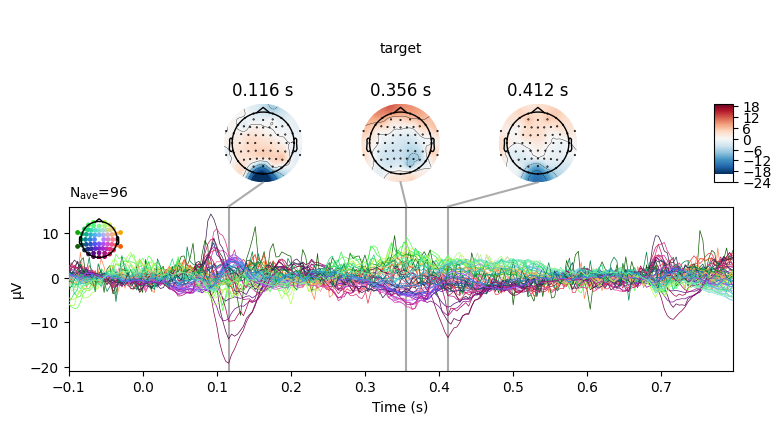

No projector specified for this dataset. Please consider the method self.add_proj.


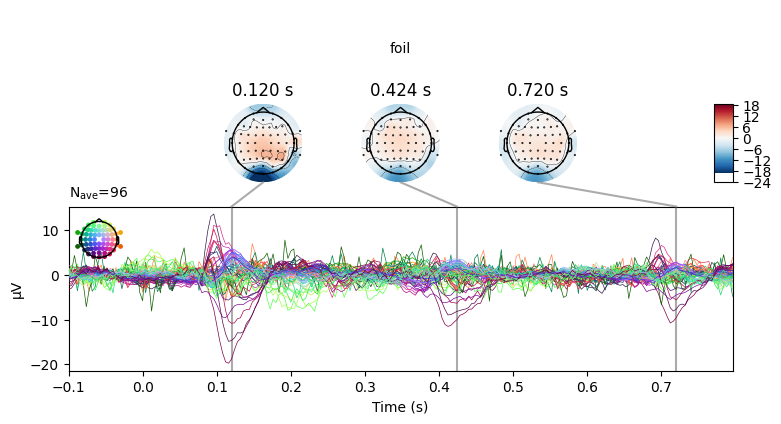

No projector specified for this dataset. Please consider the method self.add_proj.


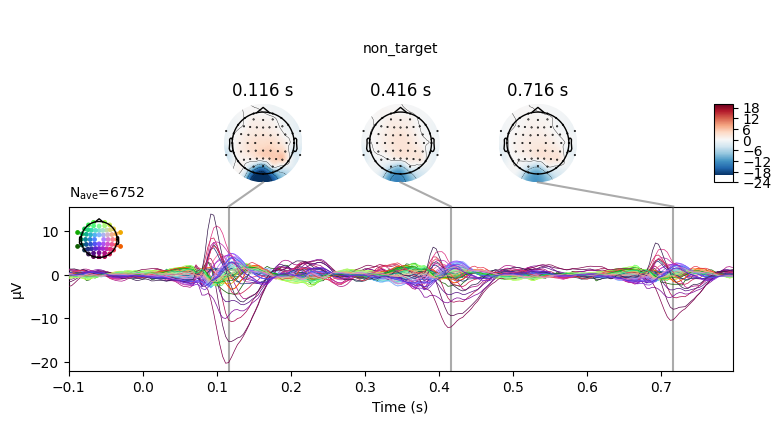







Subject_ID: 2
No projector specified for this dataset. Please consider the method self.add_proj.


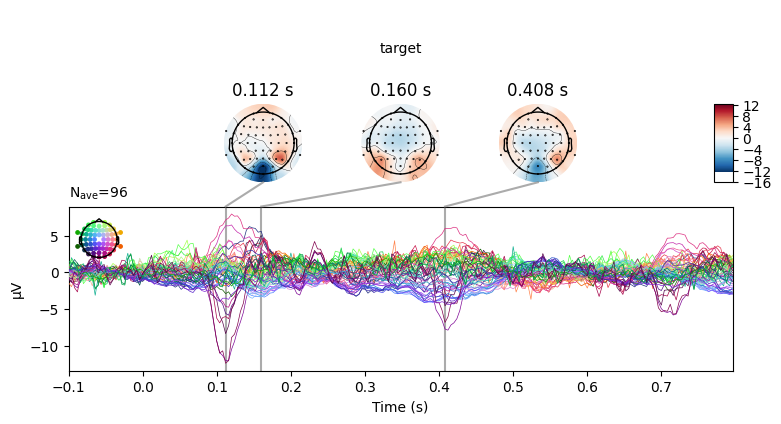

No projector specified for this dataset. Please consider the method self.add_proj.


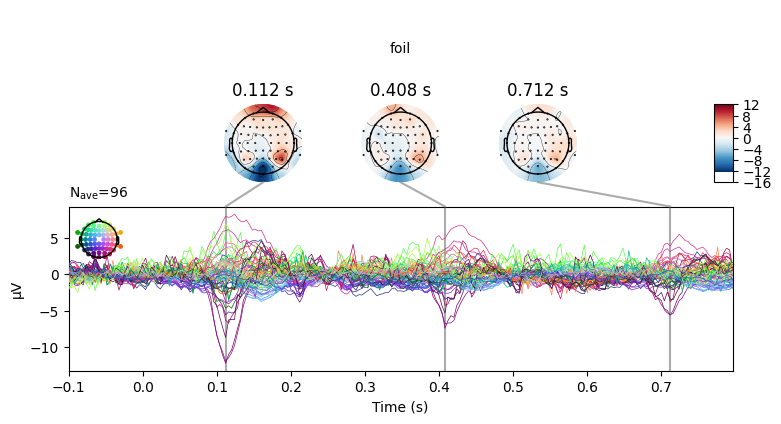

No projector specified for this dataset. Please consider the method self.add_proj.


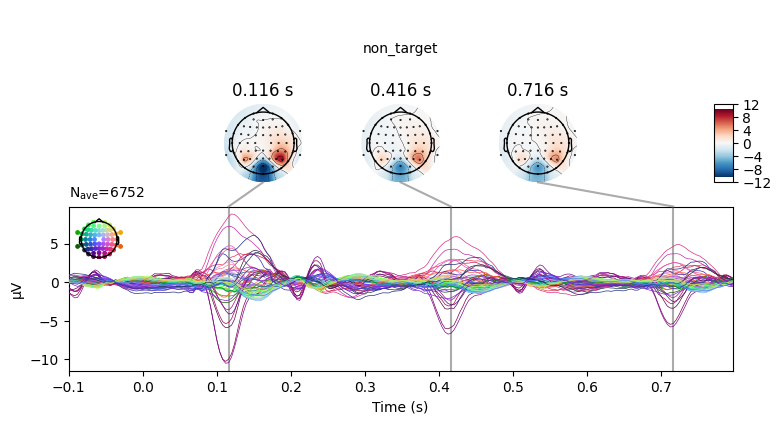







Subject_ID: 3
No projector specified for this dataset. Please consider the method self.add_proj.


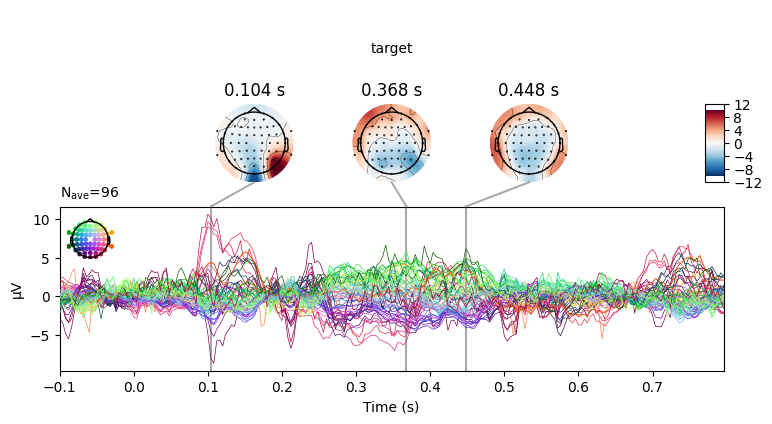

No projector specified for this dataset. Please consider the method self.add_proj.


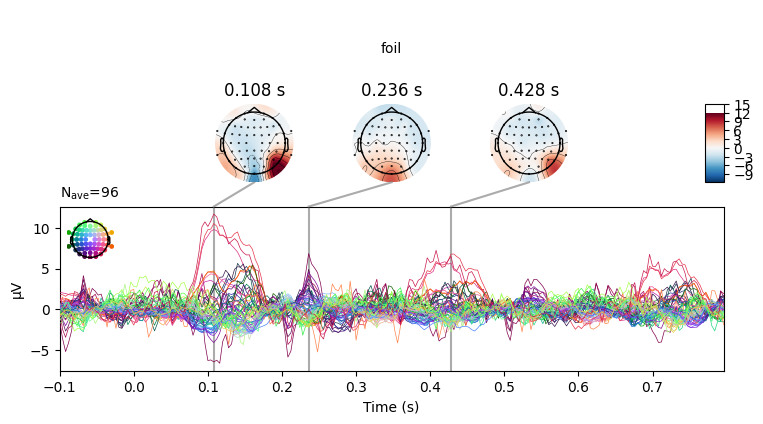

No projector specified for this dataset. Please consider the method self.add_proj.


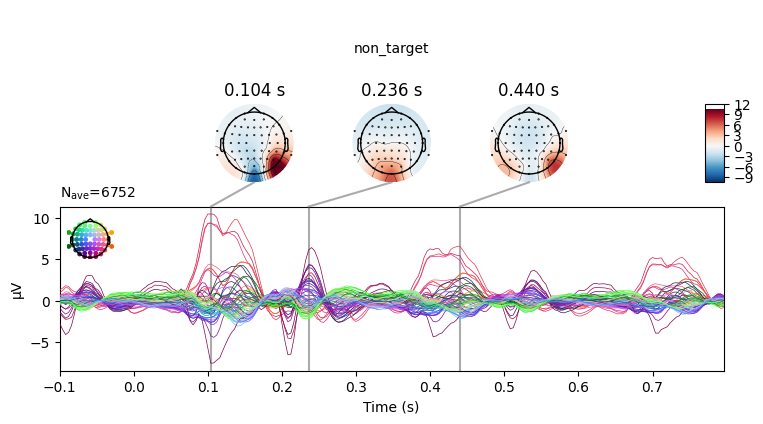







Subject_ID: 4
No projector specified for this dataset. Please consider the method self.add_proj.


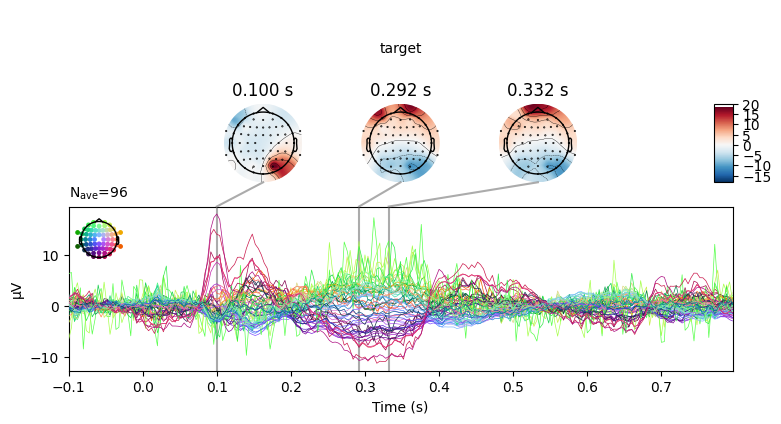

No projector specified for this dataset. Please consider the method self.add_proj.


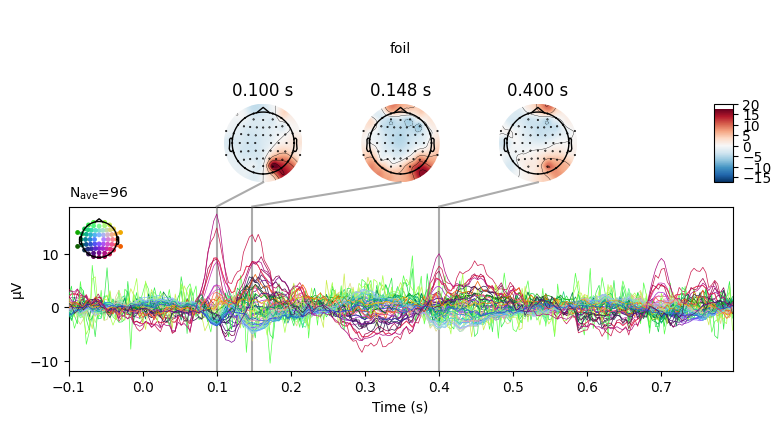

No projector specified for this dataset. Please consider the method self.add_proj.


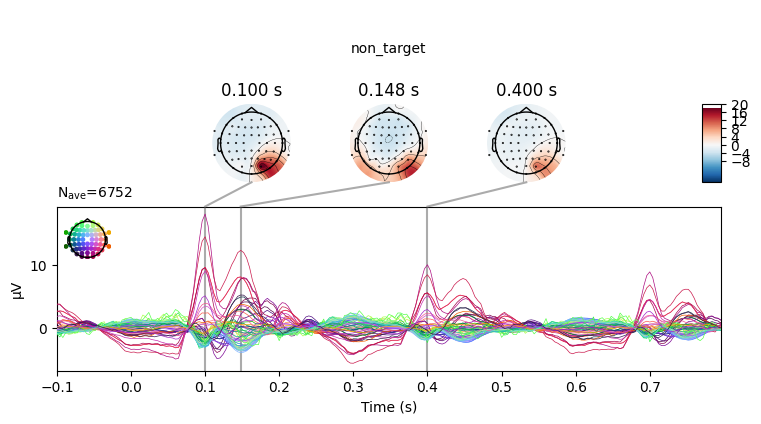







Subject_ID: 5
No projector specified for this dataset. Please consider the method self.add_proj.


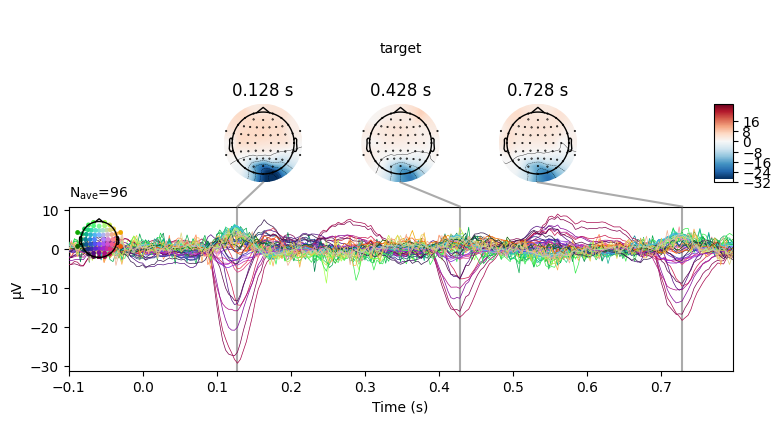

No projector specified for this dataset. Please consider the method self.add_proj.


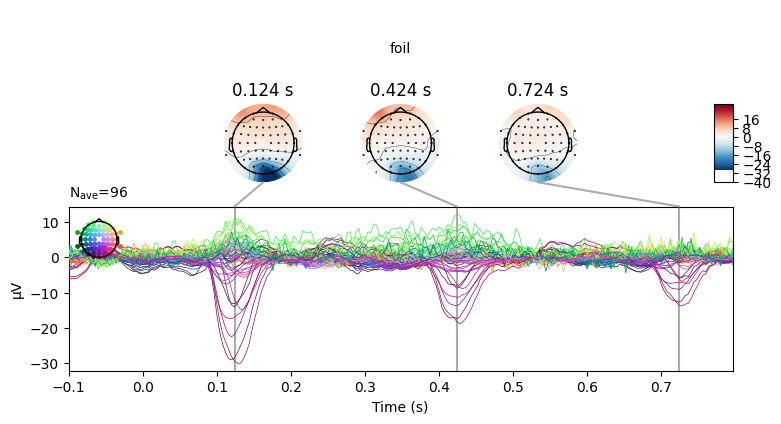

No projector specified for this dataset. Please consider the method self.add_proj.


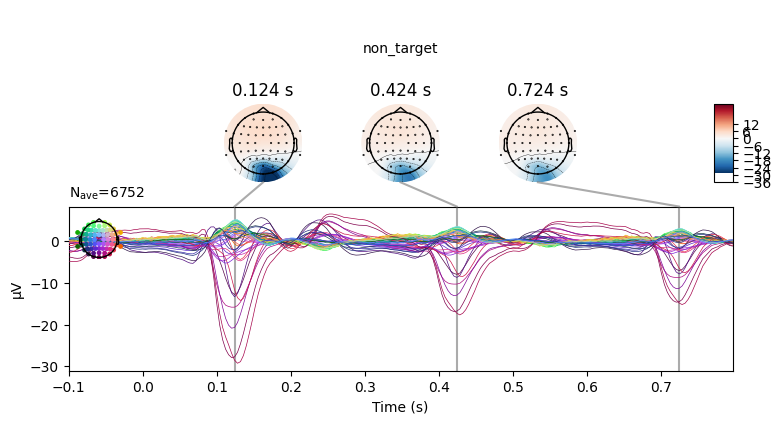







Subject_ID: 6
No projector specified for this dataset. Please consider the method self.add_proj.


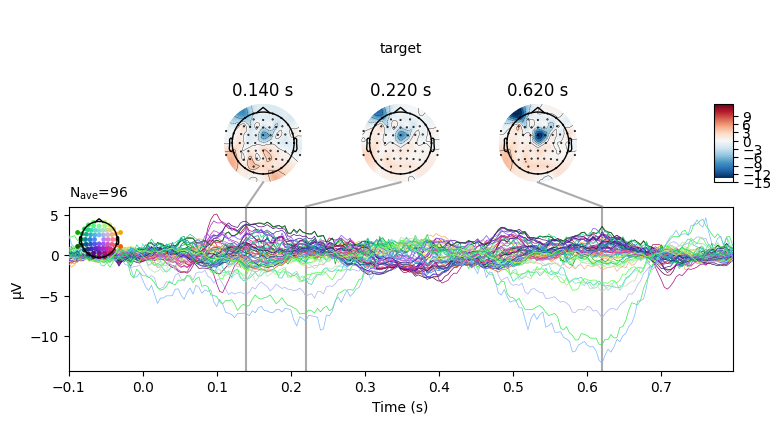

No projector specified for this dataset. Please consider the method self.add_proj.


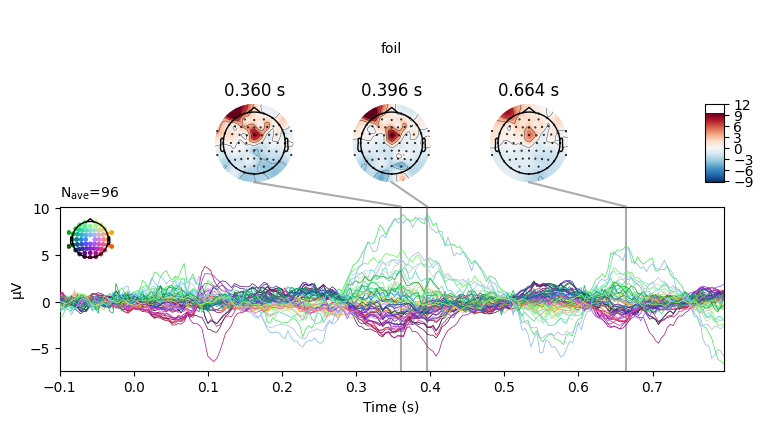

No projector specified for this dataset. Please consider the method self.add_proj.


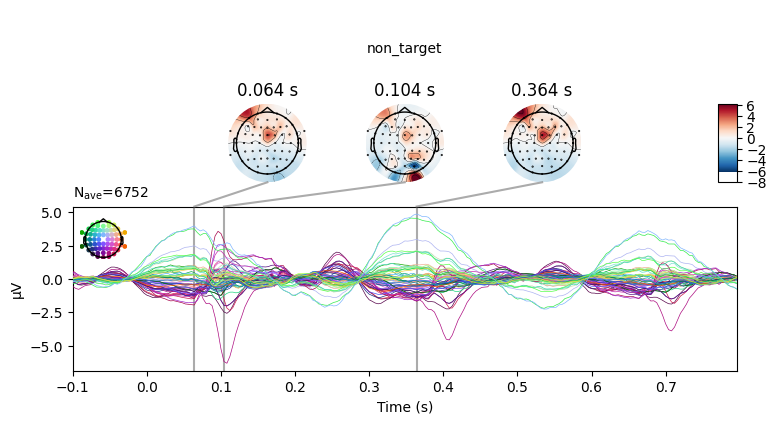







Subject_ID: 7
No projector specified for this dataset. Please consider the method self.add_proj.


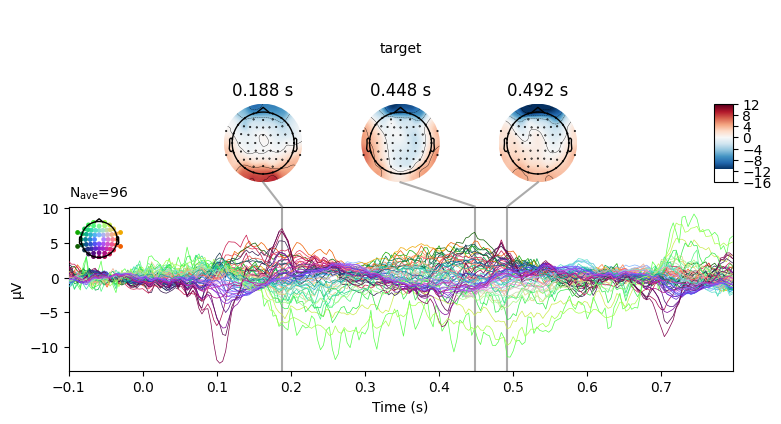

No projector specified for this dataset. Please consider the method self.add_proj.


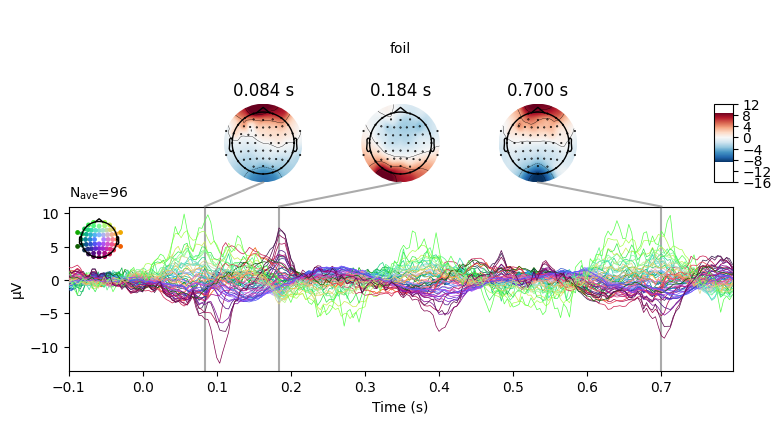

No projector specified for this dataset. Please consider the method self.add_proj.


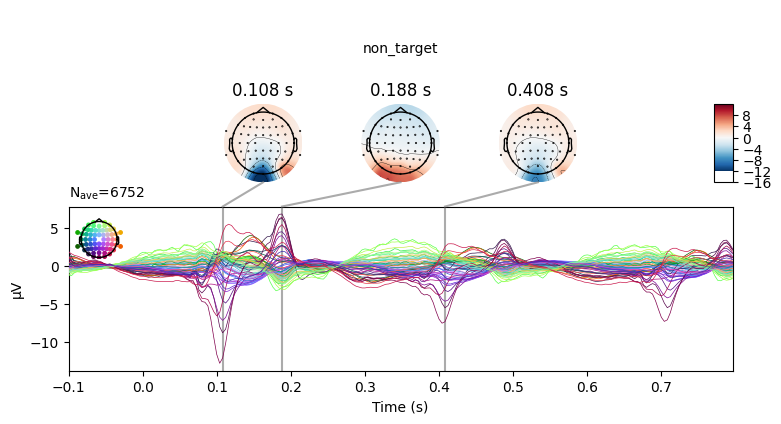







Subject_ID: 8
No projector specified for this dataset. Please consider the method self.add_proj.


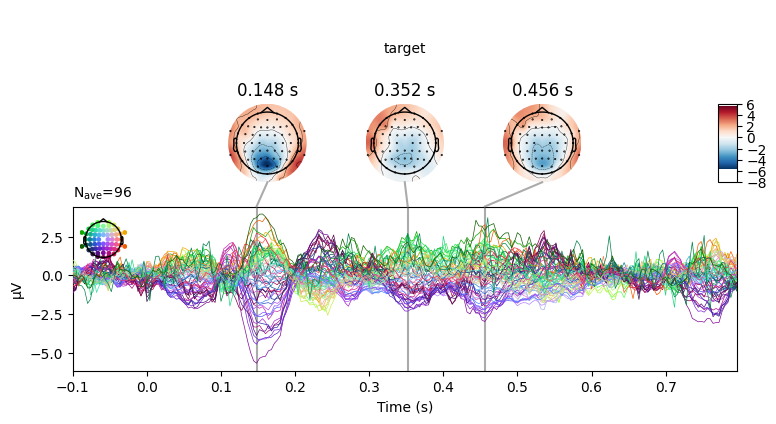

No projector specified for this dataset. Please consider the method self.add_proj.


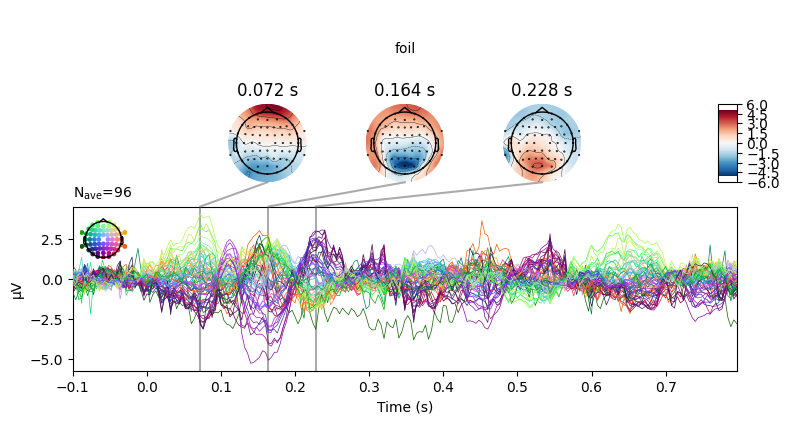

No projector specified for this dataset. Please consider the method self.add_proj.


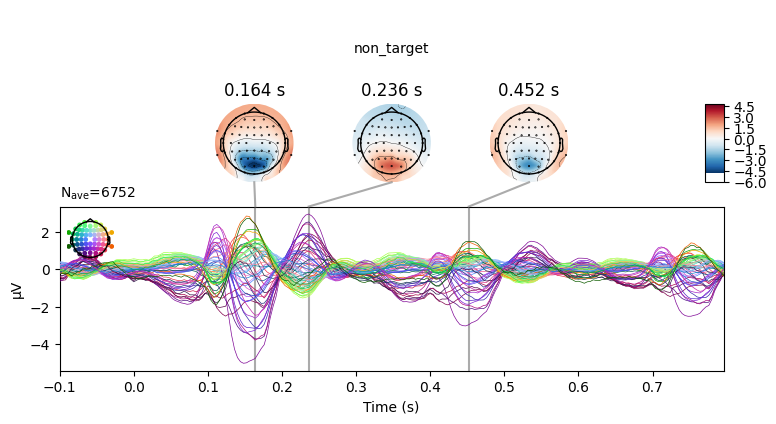







Subject_ID: 9
No projector specified for this dataset. Please consider the method self.add_proj.


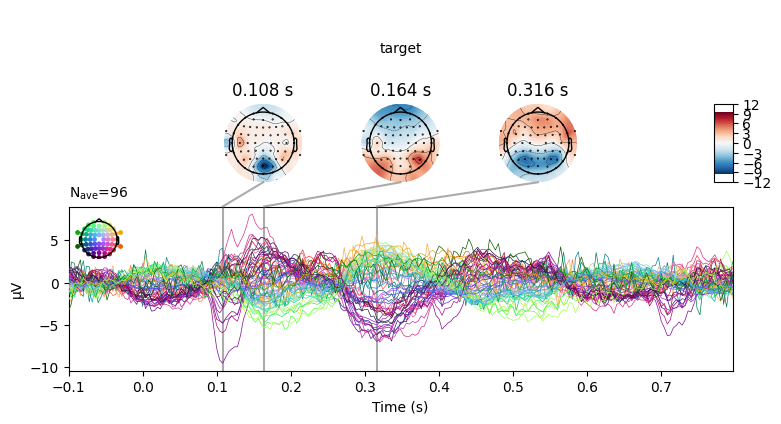

No projector specified for this dataset. Please consider the method self.add_proj.


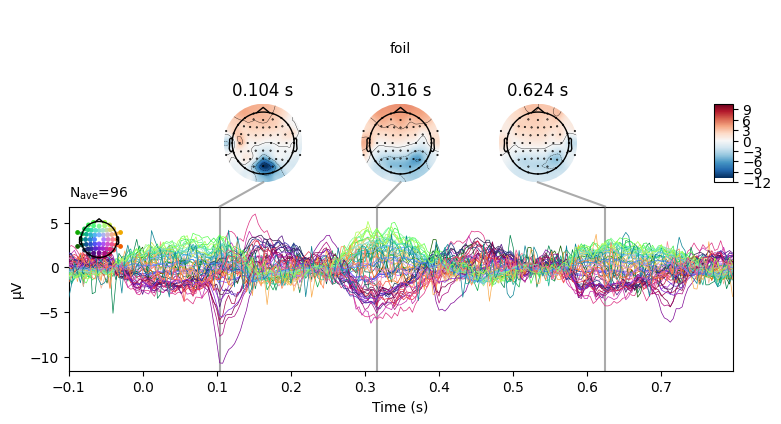

No projector specified for this dataset. Please consider the method self.add_proj.


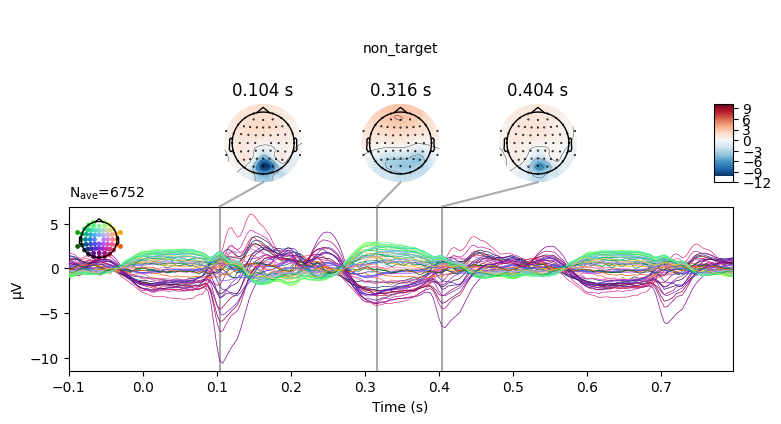







Subject_ID: 10
No projector specified for this dataset. Please consider the method self.add_proj.


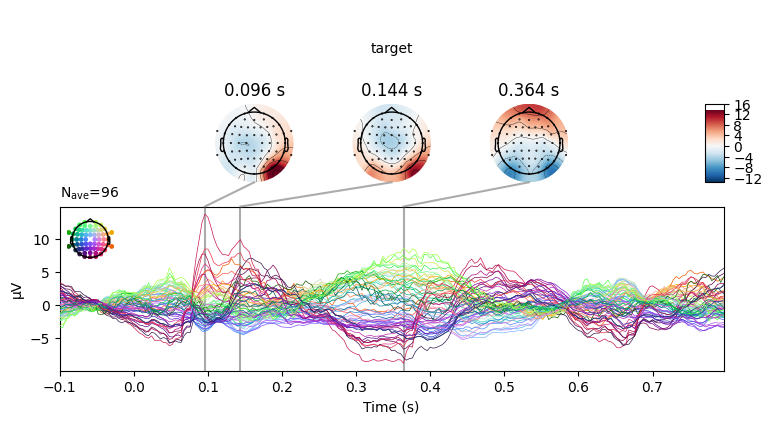

No projector specified for this dataset. Please consider the method self.add_proj.


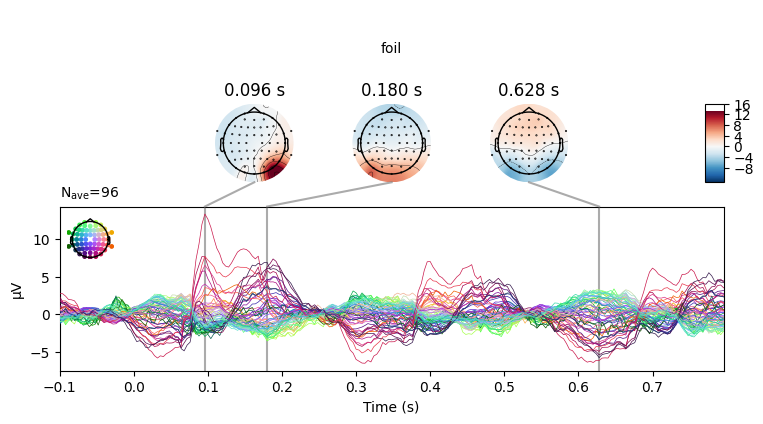

No projector specified for this dataset. Please consider the method self.add_proj.


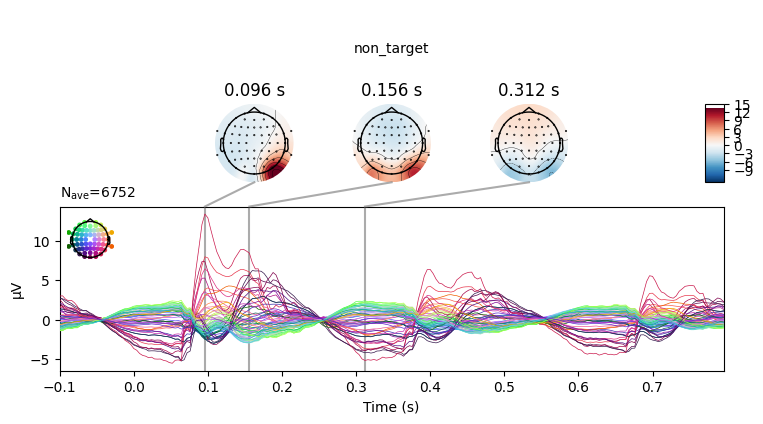







Subject_ID: 11
No projector specified for this dataset. Please consider the method self.add_proj.


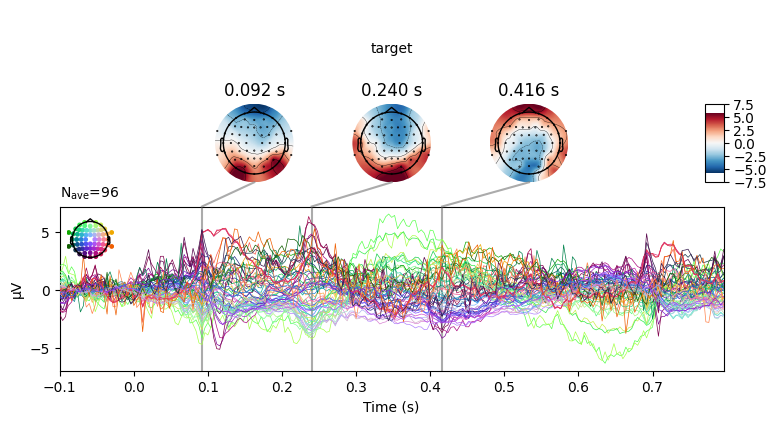

No projector specified for this dataset. Please consider the method self.add_proj.


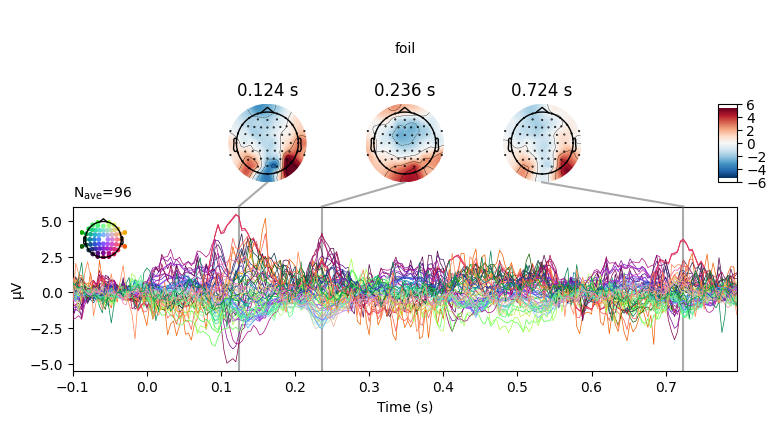

No projector specified for this dataset. Please consider the method self.add_proj.


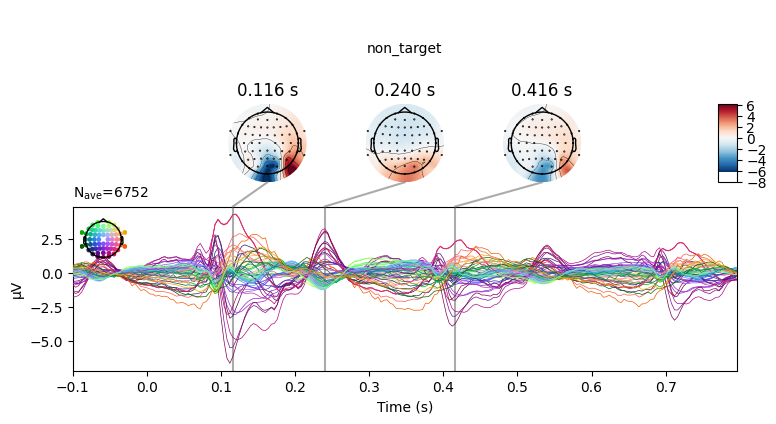







Subject_ID: 12
No projector specified for this dataset. Please consider the method self.add_proj.


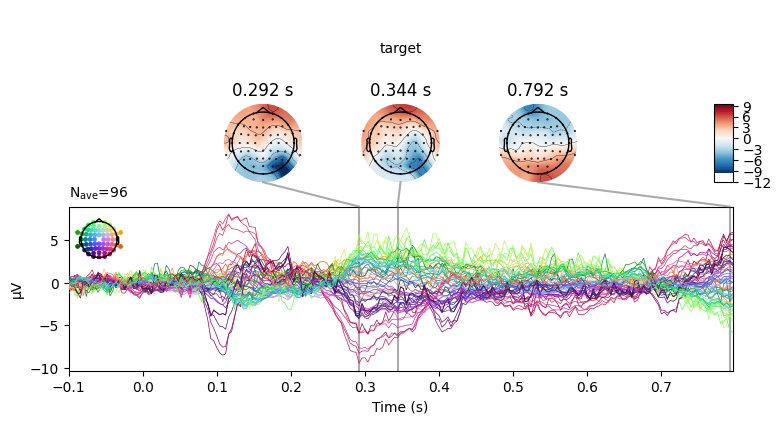

No projector specified for this dataset. Please consider the method self.add_proj.


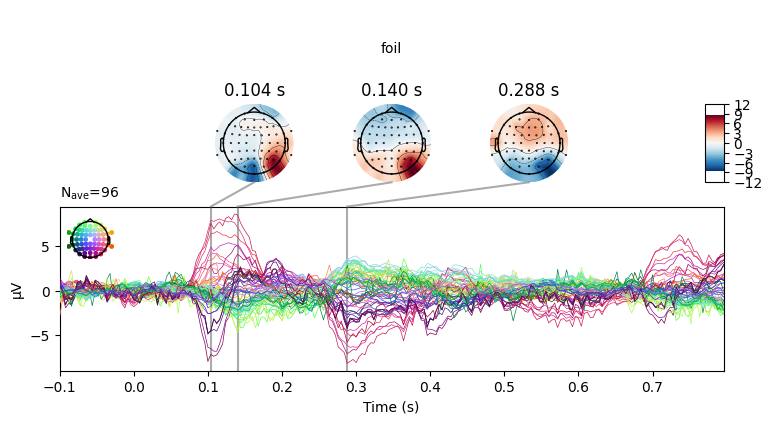

No projector specified for this dataset. Please consider the method self.add_proj.


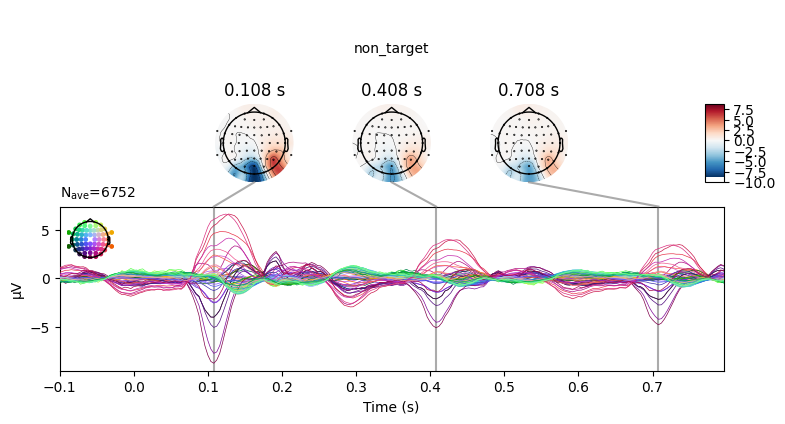







Subject_ID: 13
No projector specified for this dataset. Please consider the method self.add_proj.


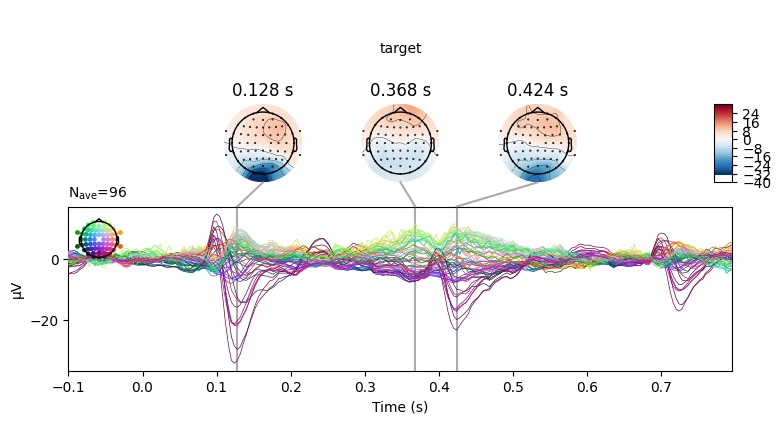

No projector specified for this dataset. Please consider the method self.add_proj.


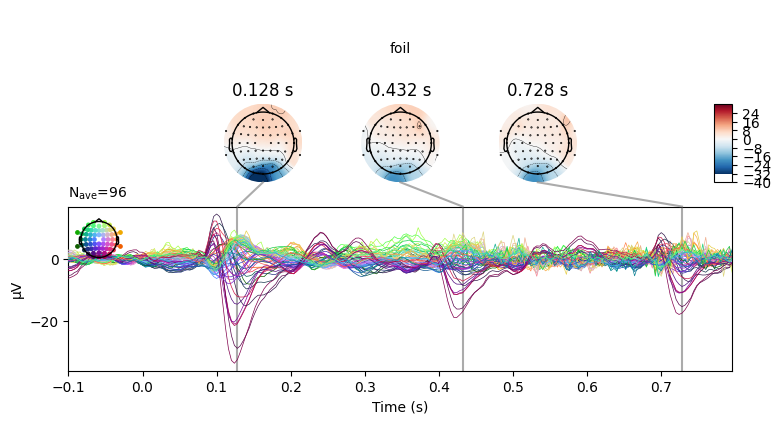

No projector specified for this dataset. Please consider the method self.add_proj.


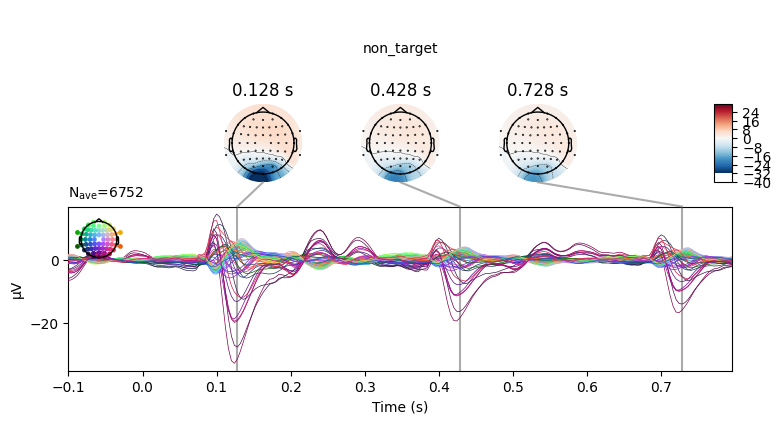







Subject_ID: 14
No projector specified for this dataset. Please consider the method self.add_proj.


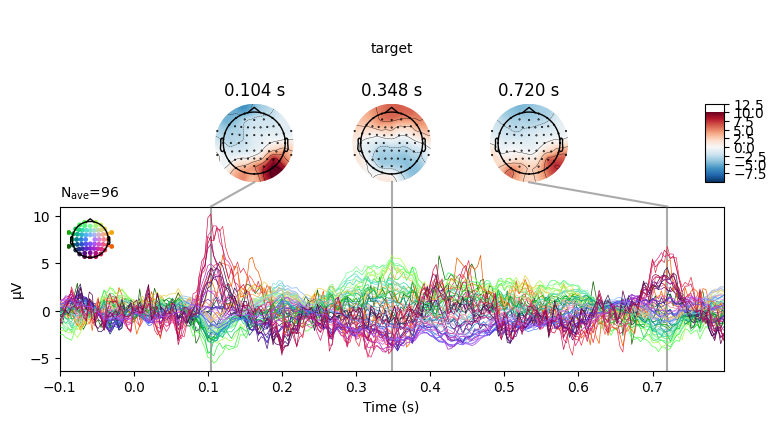

No projector specified for this dataset. Please consider the method self.add_proj.


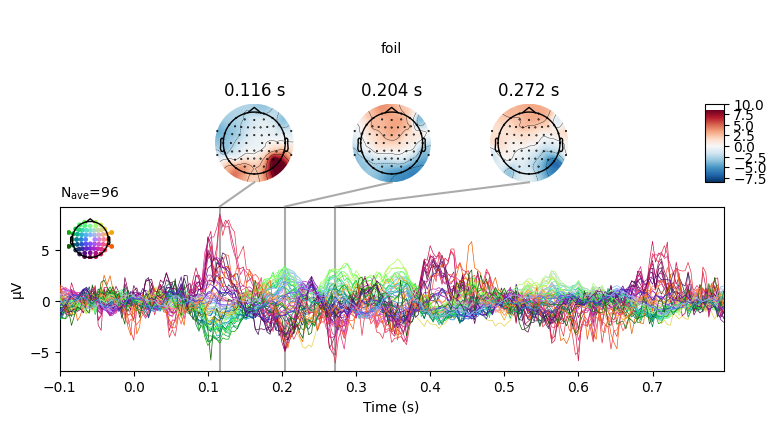

No projector specified for this dataset. Please consider the method self.add_proj.


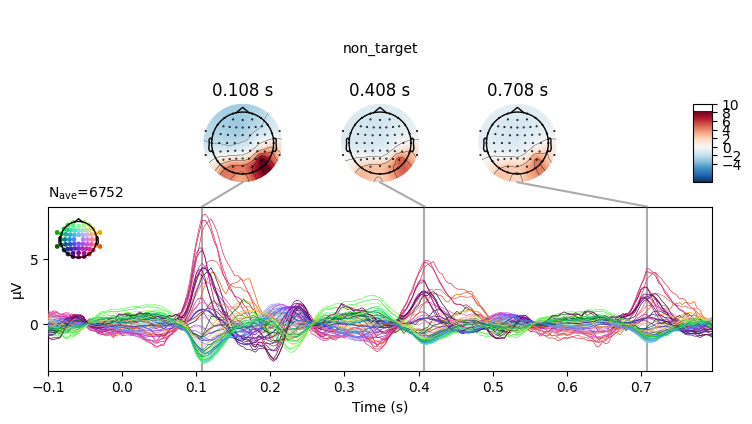







Subject_ID: 15
No projector specified for this dataset. Please consider the method self.add_proj.


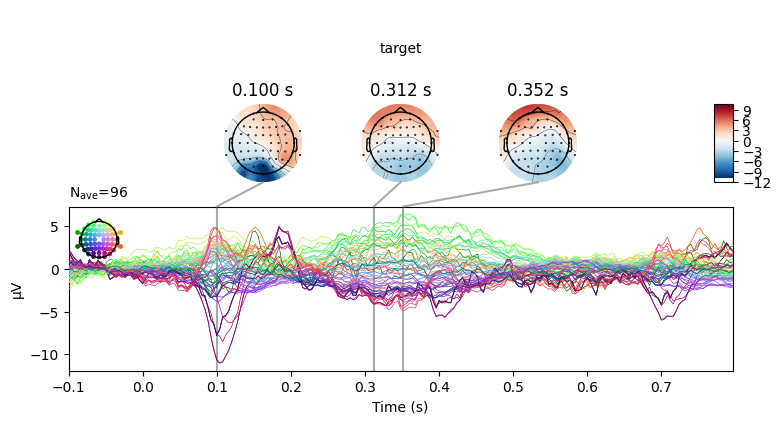

No projector specified for this dataset. Please consider the method self.add_proj.


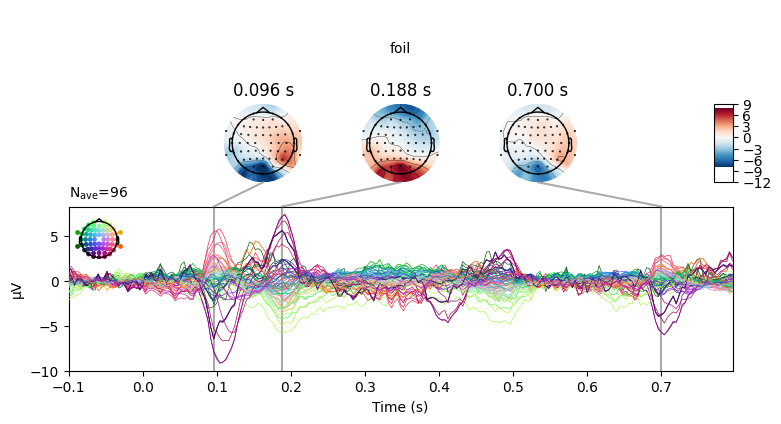

No projector specified for this dataset. Please consider the method self.add_proj.


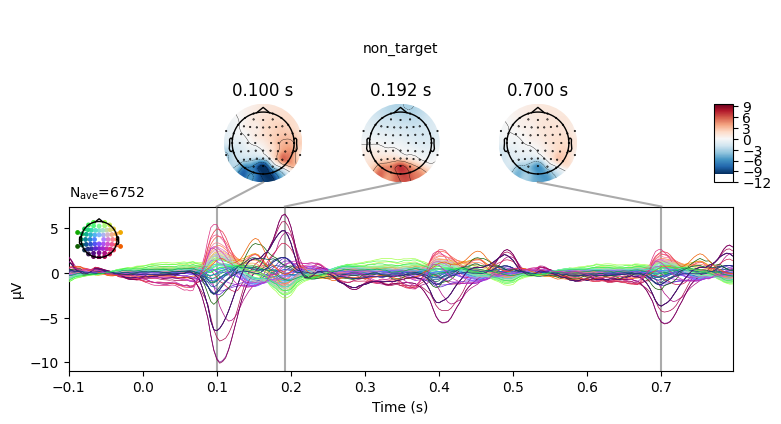







Subject_ID: 16
No projector specified for this dataset. Please consider the method self.add_proj.


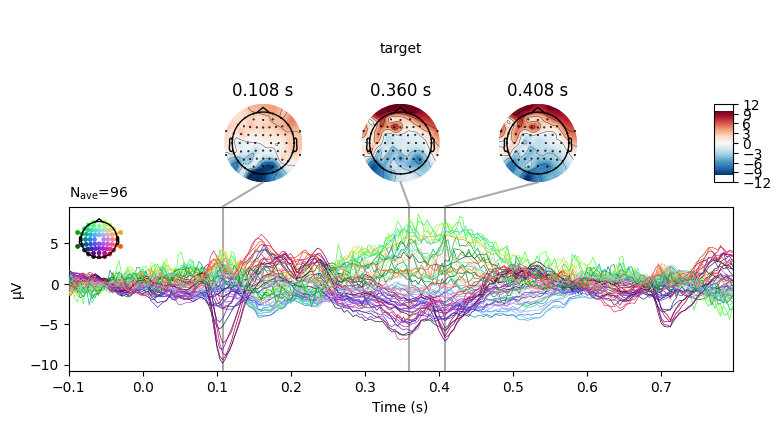

No projector specified for this dataset. Please consider the method self.add_proj.


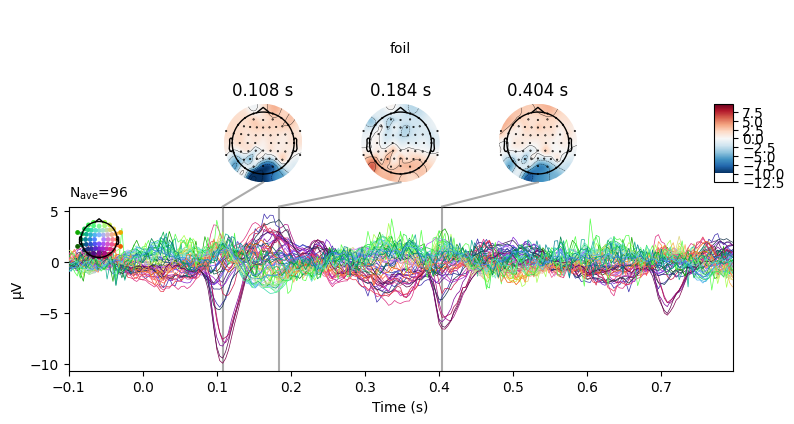

No projector specified for this dataset. Please consider the method self.add_proj.


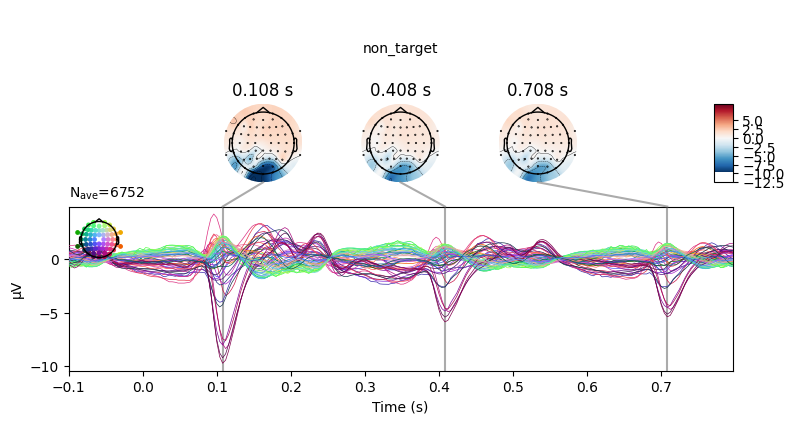







Subject_ID: 17
No projector specified for this dataset. Please consider the method self.add_proj.


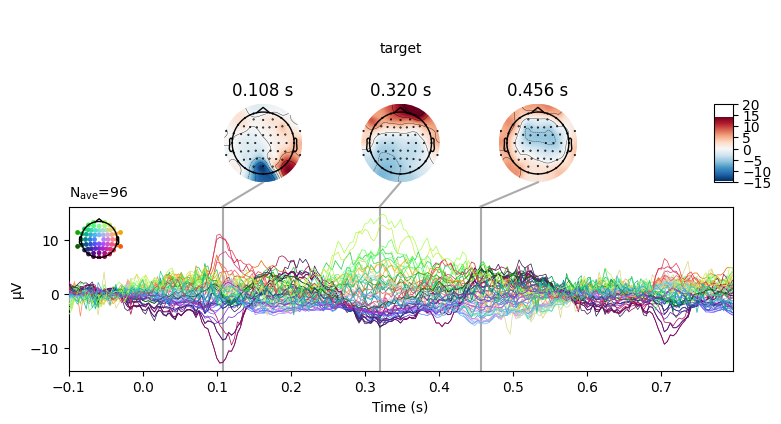

No projector specified for this dataset. Please consider the method self.add_proj.


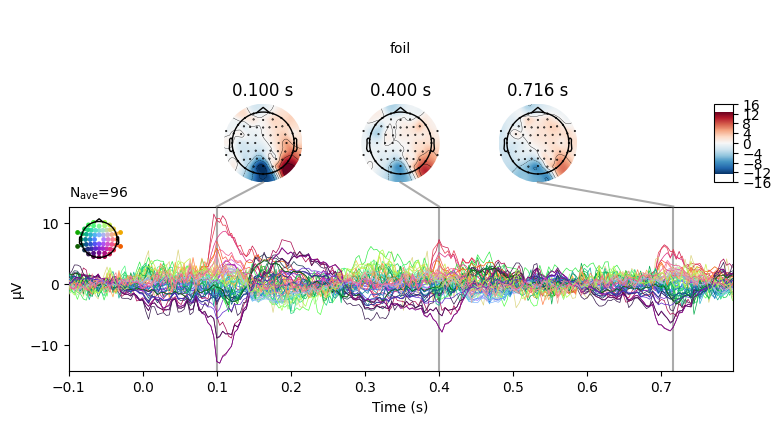

No projector specified for this dataset. Please consider the method self.add_proj.


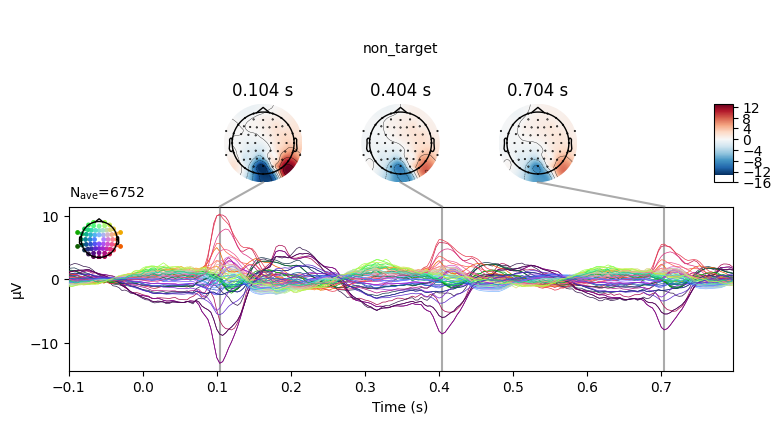







Subject_ID: 18
No projector specified for this dataset. Please consider the method self.add_proj.


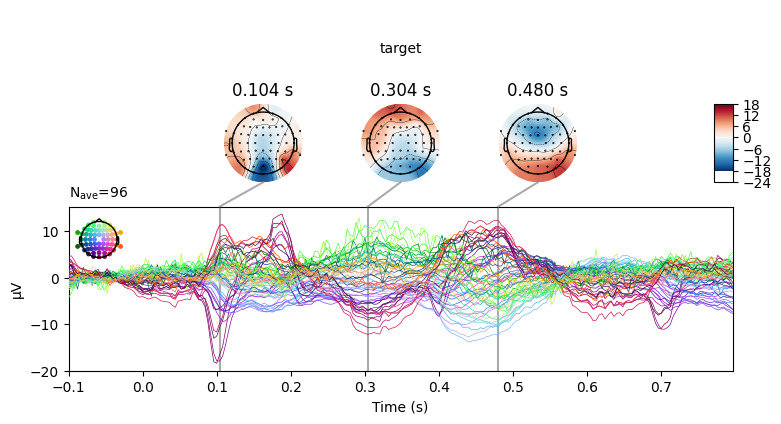

No projector specified for this dataset. Please consider the method self.add_proj.


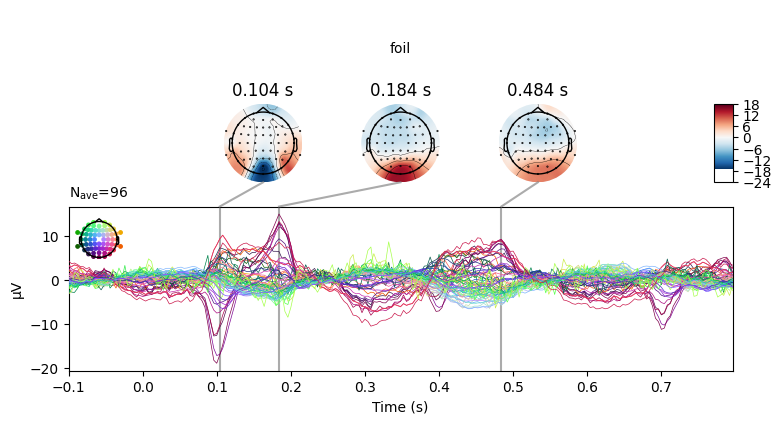

No projector specified for this dataset. Please consider the method self.add_proj.


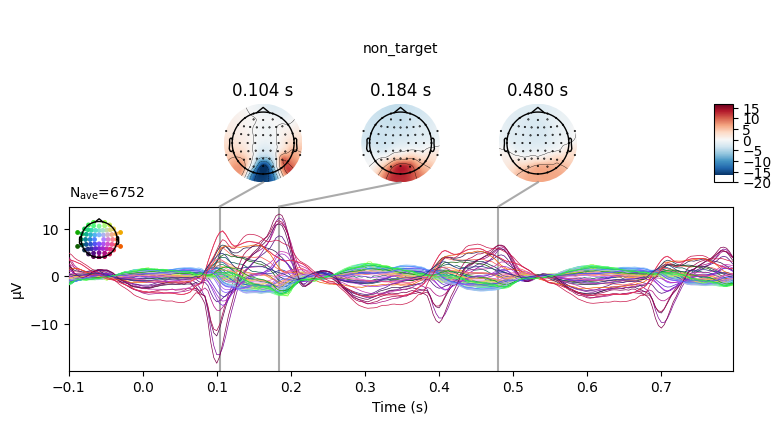







Subject_ID: 19
No projector specified for this dataset. Please consider the method self.add_proj.


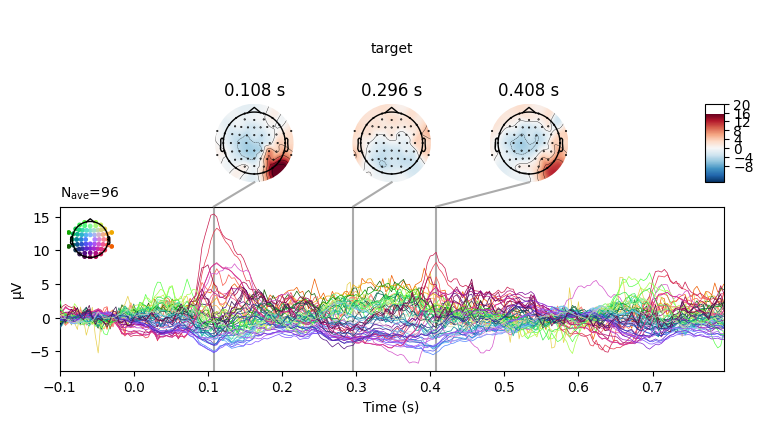

No projector specified for this dataset. Please consider the method self.add_proj.


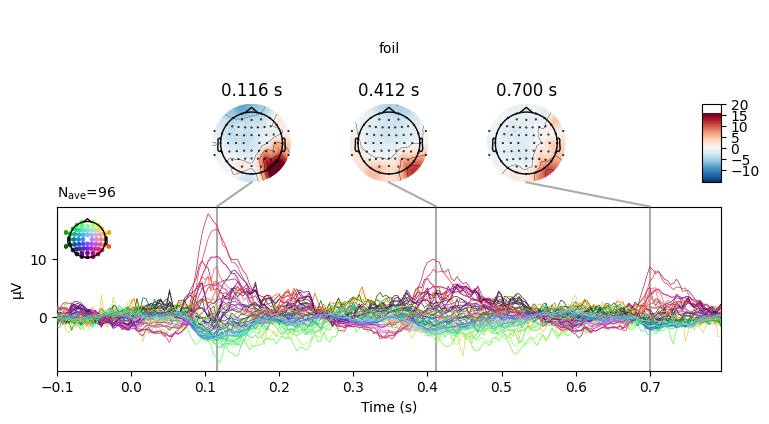

No projector specified for this dataset. Please consider the method self.add_proj.


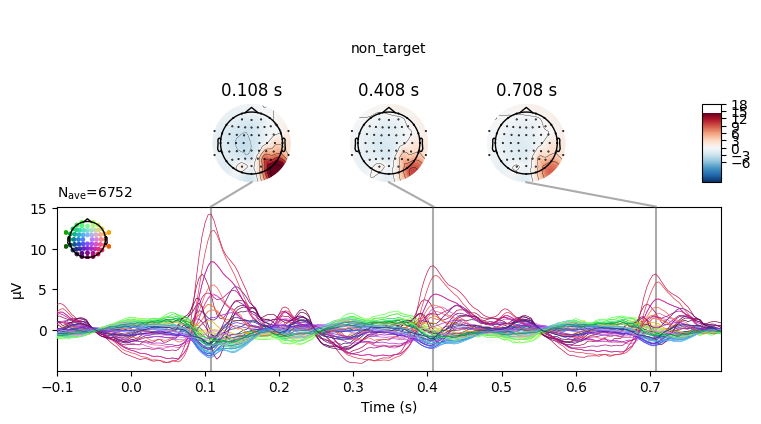







Subject_ID: 20
No projector specified for this dataset. Please consider the method self.add_proj.


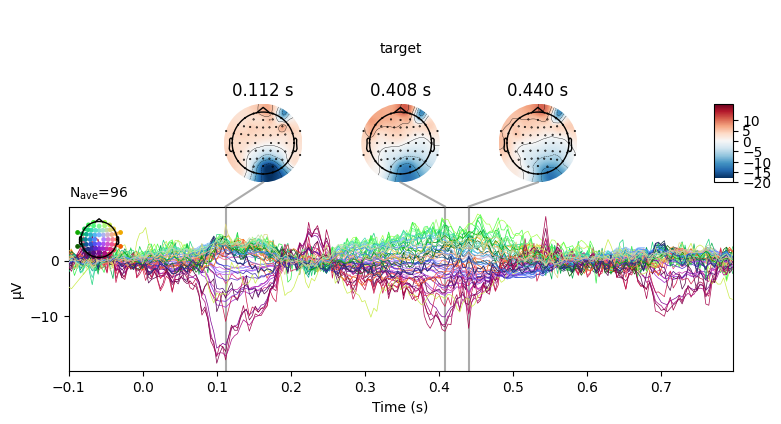

No projector specified for this dataset. Please consider the method self.add_proj.


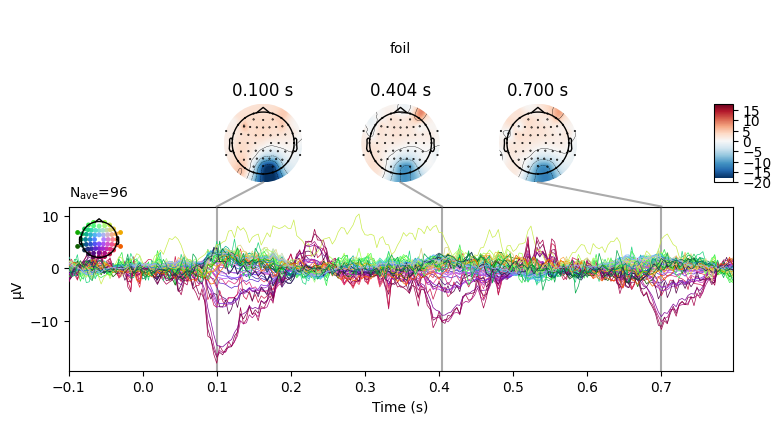

No projector specified for this dataset. Please consider the method self.add_proj.


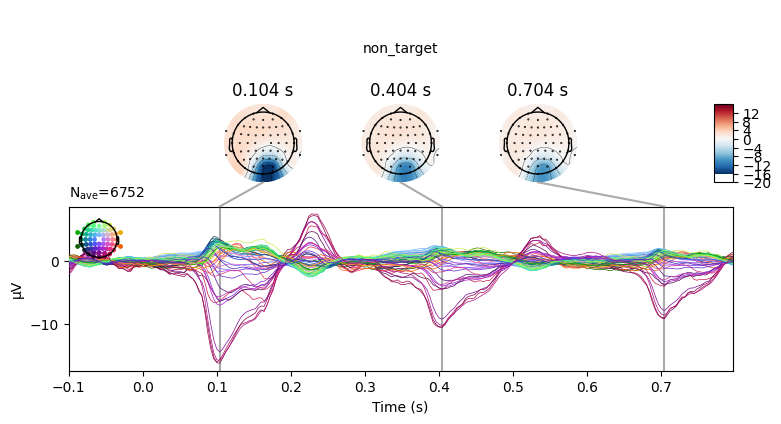

In [ ]:
for id,t,f,n in zip(subject_ids, evoked_all['target'], evoked_all['foil'], evoked_all['non_target']):
  print('Subject_ID: '+str(id))
  individual_ERP(t,f,n)
  print('\n'*5)

###Average

Computing averages and contrast of target and foil ERPs


No projector specified for this dataset. Please consider the method self.add_proj.


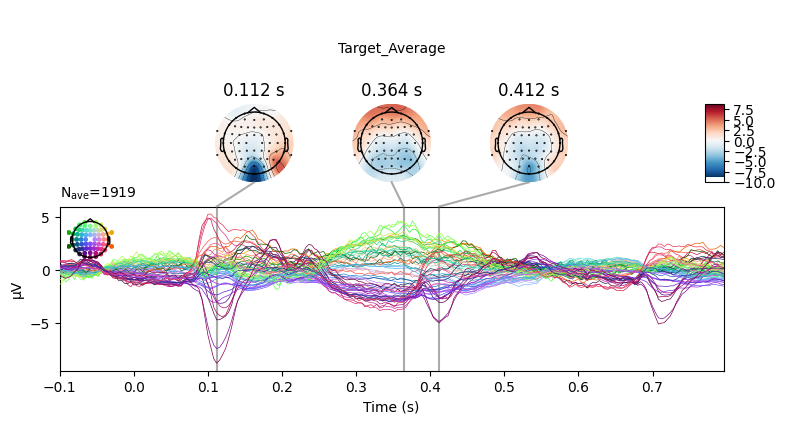

No projector specified for this dataset. Please consider the method self.add_proj.


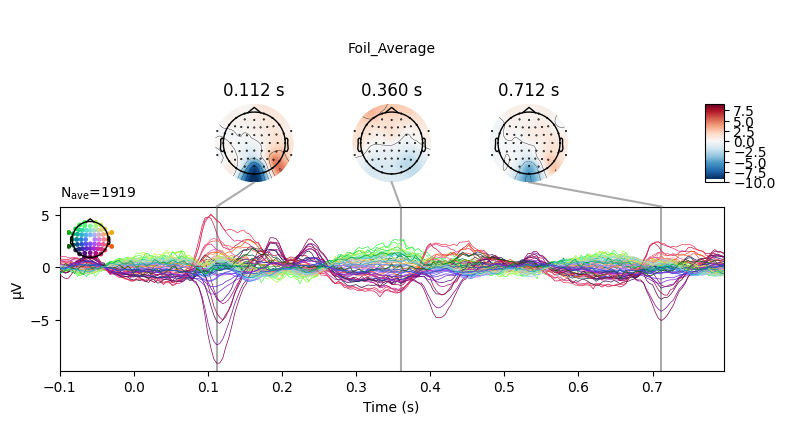

No projector specified for this dataset. Please consider the method self.add_proj.


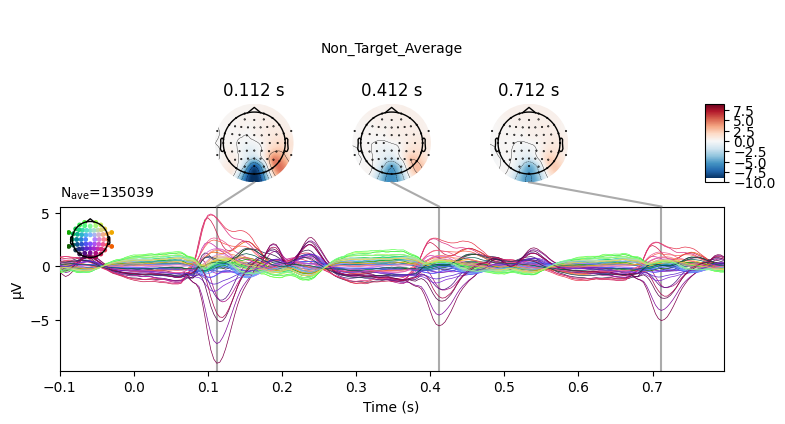



No projector specified for this dataset. Please consider the method self.add_proj.


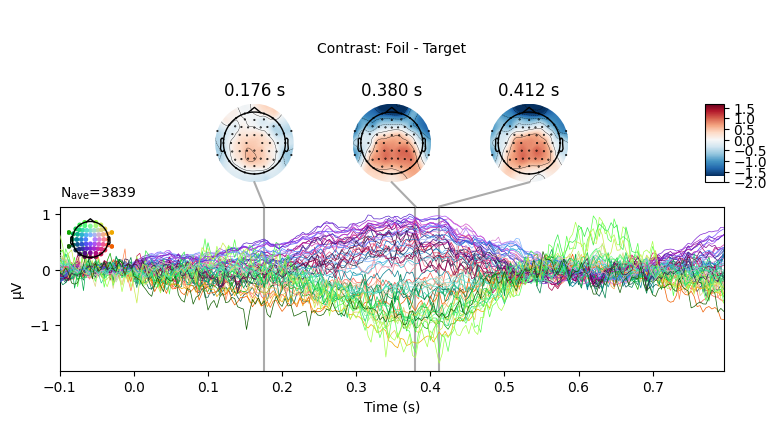

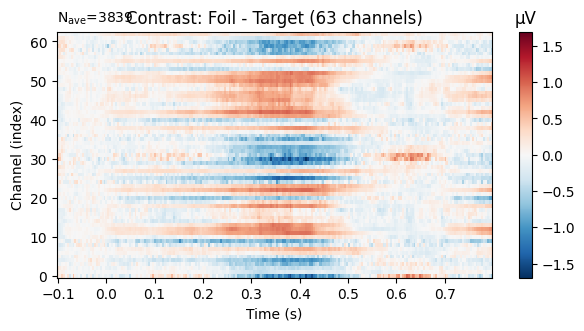



No projector specified for this dataset. Please consider the method self.add_proj.


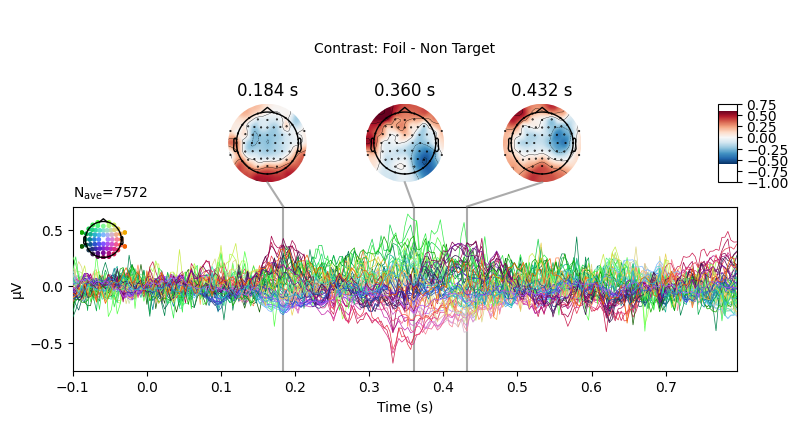

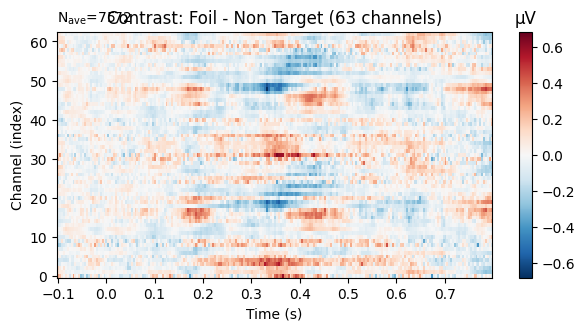



No projector specified for this dataset. Please consider the method self.add_proj.


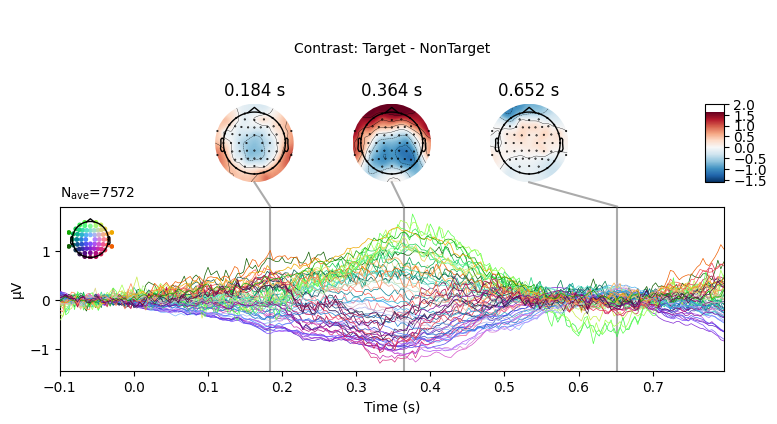

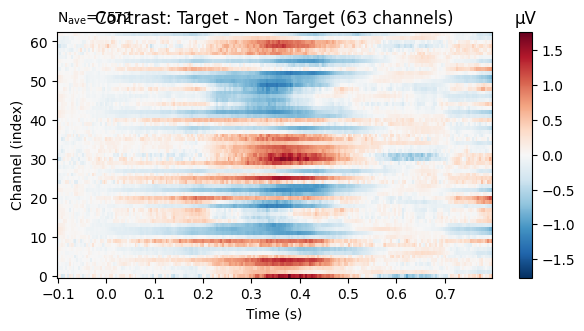

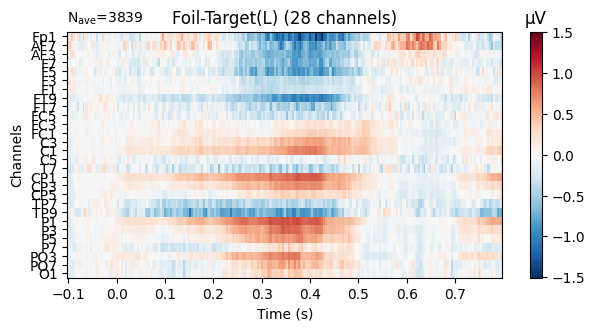

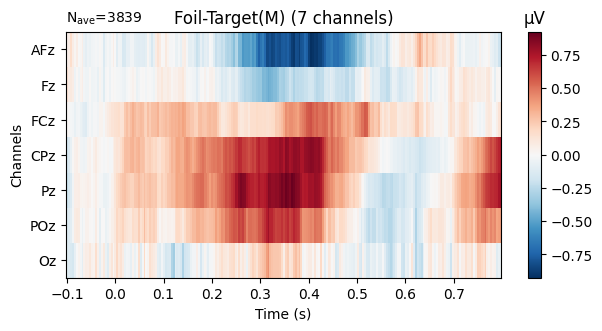

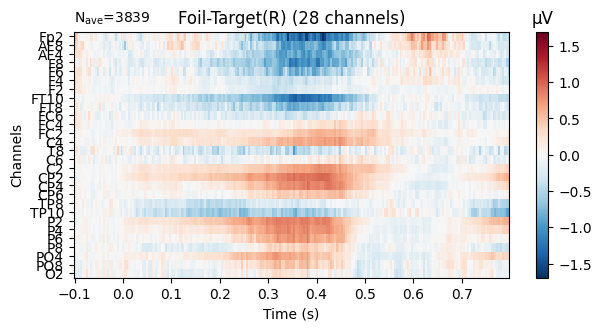



Computing time frequency power average and contrast of target and foil epochs
No baseline correction applied
No baseline correction applied


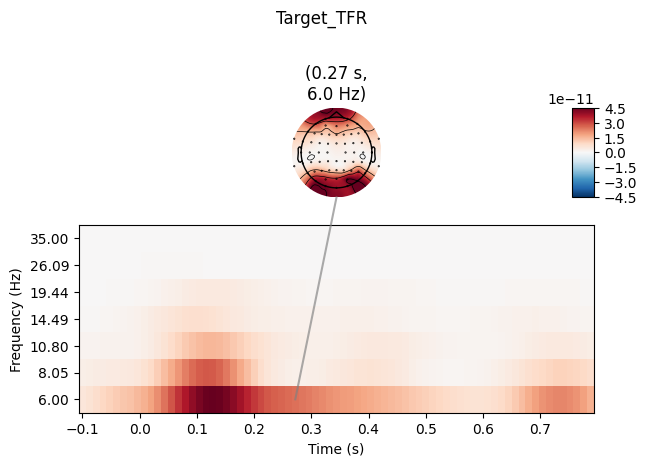



No baseline correction applied
No baseline correction applied


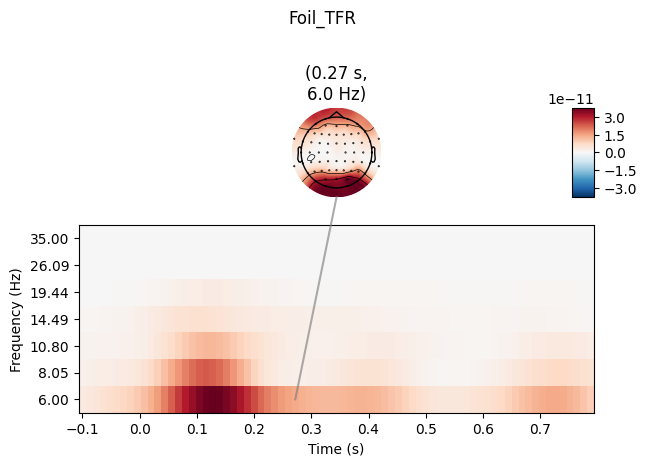



Applying baseline correction (mode: mean)
No baseline correction applied
No baseline correction applied


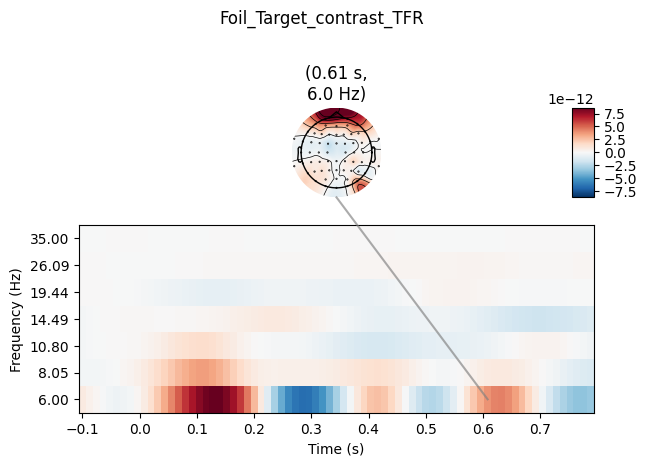

In [ ]:
ERP_TFR_contrast(evoked_all)

##With ICA

###Get evoked data

In [ ]:
subject_ids = range(1,21)
ica_evoked_all = load_pickle(os.path.join(drive_output_path, 'ica_evoked_all'))

####Compute evoked data

In [ ]:
ica_evoked_all = get_all_evoked(ids=subject_ids, ica_apply=True)
save_pickle(os.path.join(drive_output_path, 'ica_evoked_all'), ica_evoked_all)

###Individual

Subject_ID: 1
No projector specified for this dataset. Please consider the method self.add_proj.


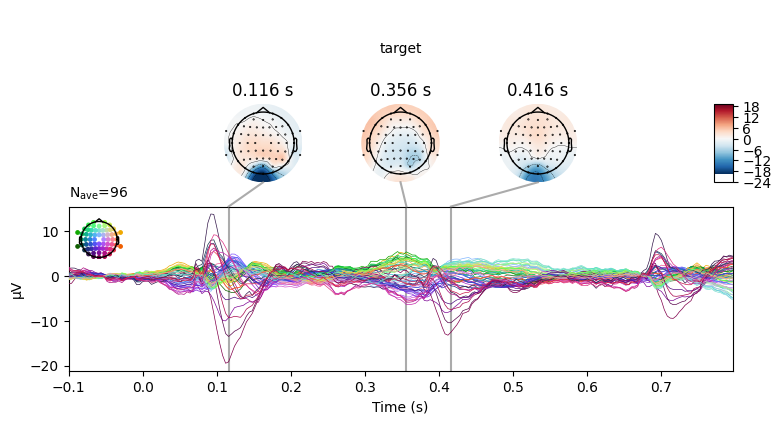

No projector specified for this dataset. Please consider the method self.add_proj.


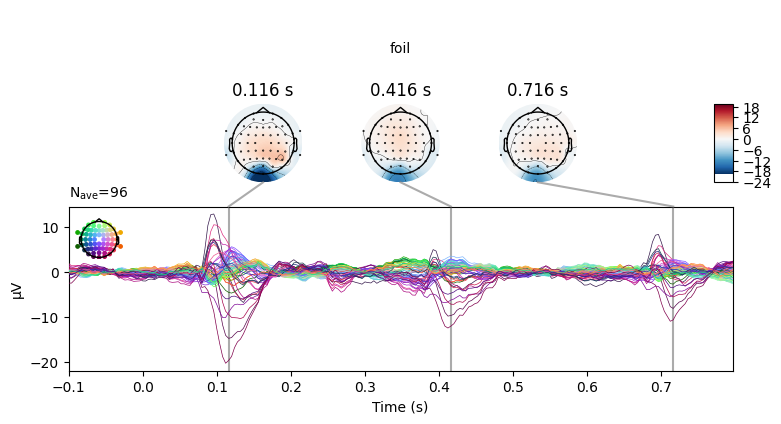

No projector specified for this dataset. Please consider the method self.add_proj.


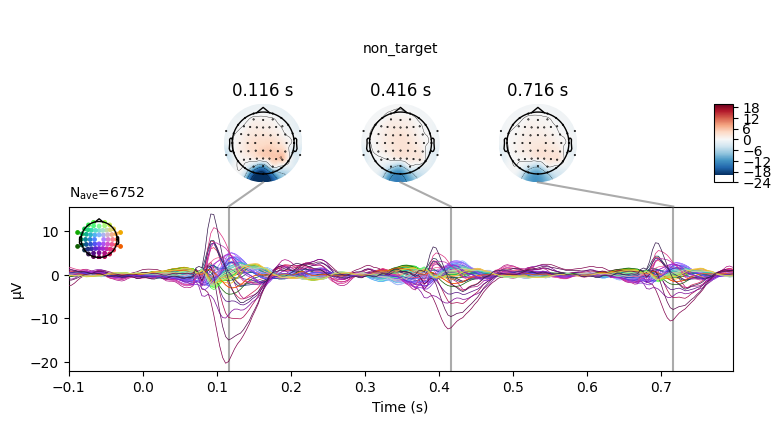







Subject_ID: 2
No projector specified for this dataset. Please consider the method self.add_proj.


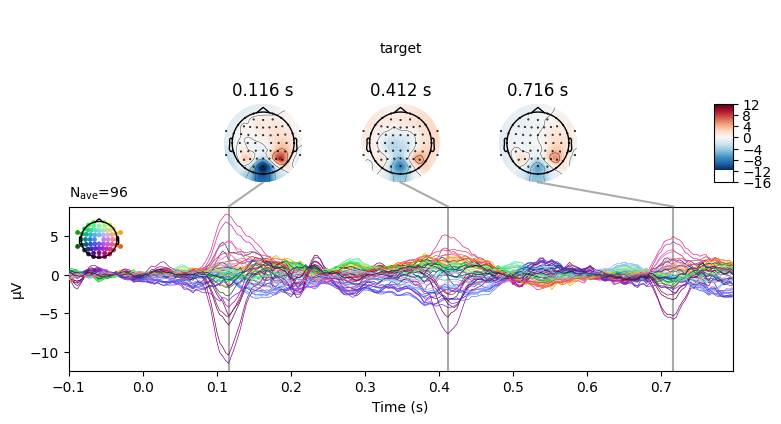

No projector specified for this dataset. Please consider the method self.add_proj.


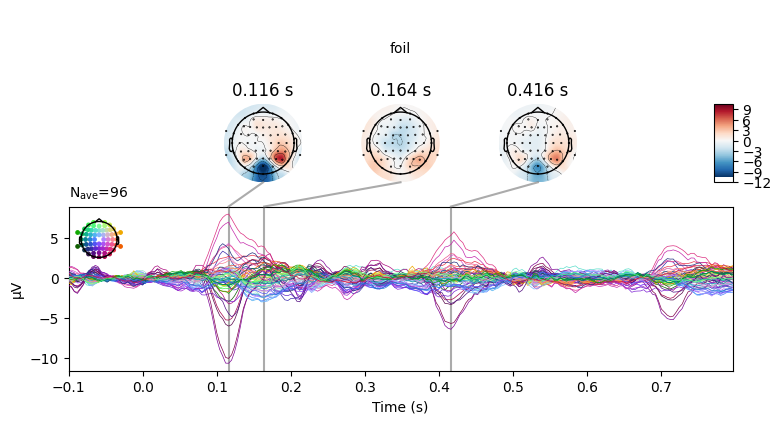

No projector specified for this dataset. Please consider the method self.add_proj.


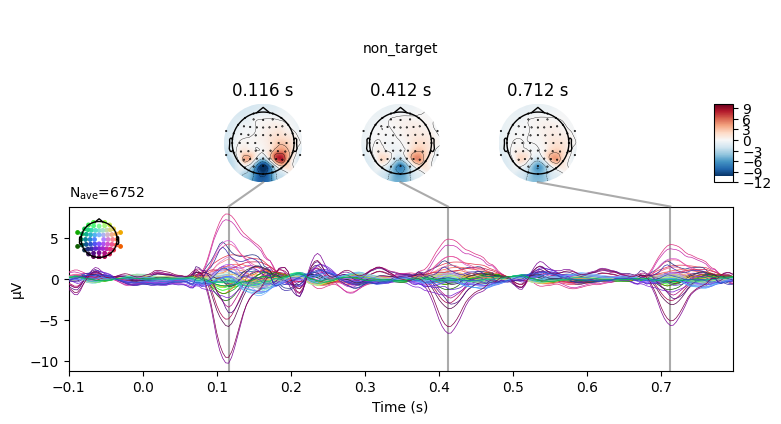







Subject_ID: 3
No projector specified for this dataset. Please consider the method self.add_proj.


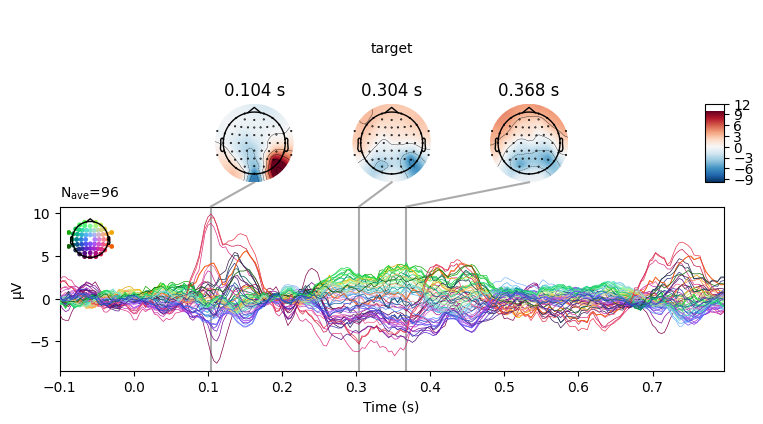

No projector specified for this dataset. Please consider the method self.add_proj.


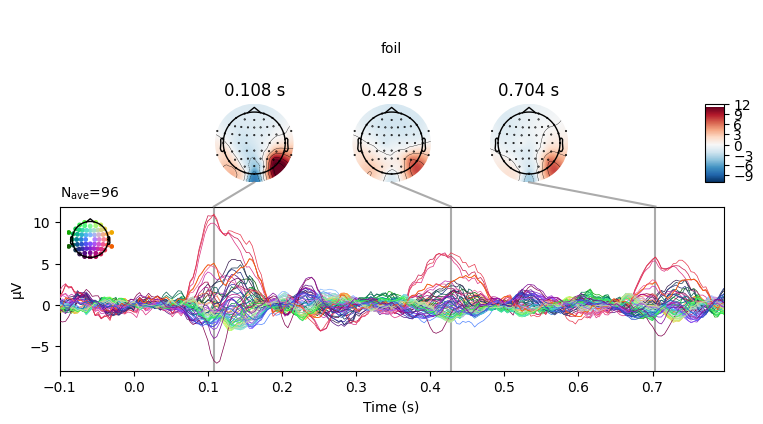

No projector specified for this dataset. Please consider the method self.add_proj.


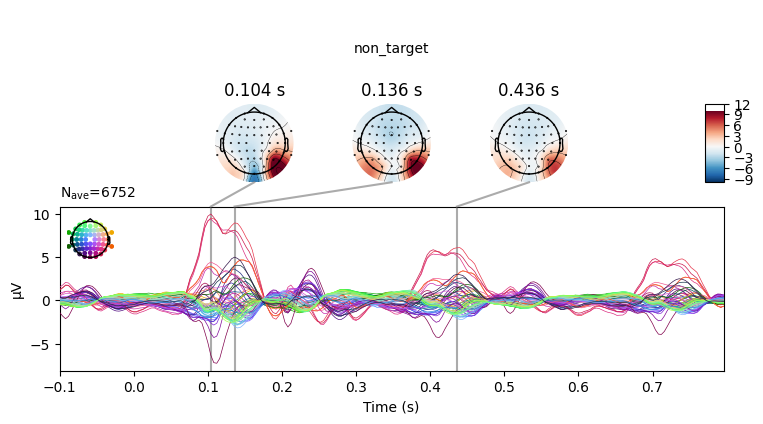







Subject_ID: 4
No projector specified for this dataset. Please consider the method self.add_proj.


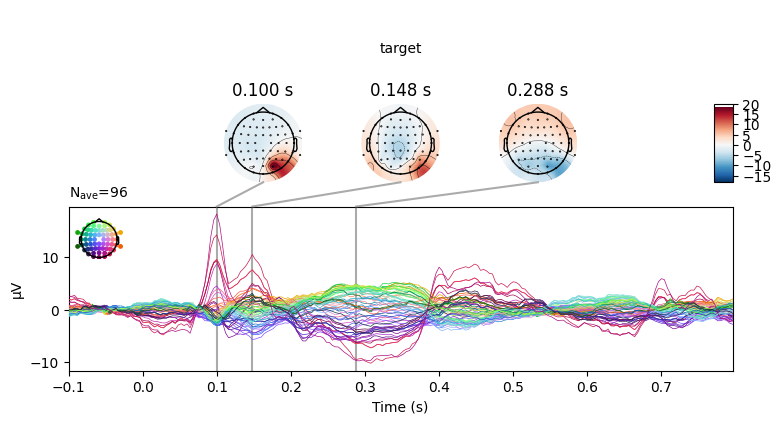

No projector specified for this dataset. Please consider the method self.add_proj.


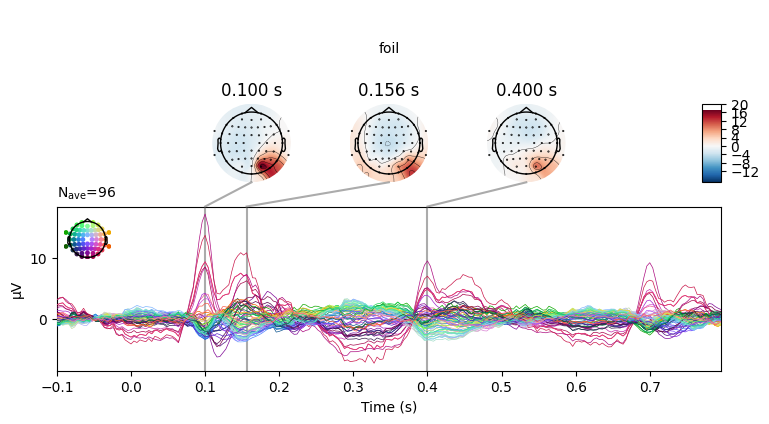

No projector specified for this dataset. Please consider the method self.add_proj.


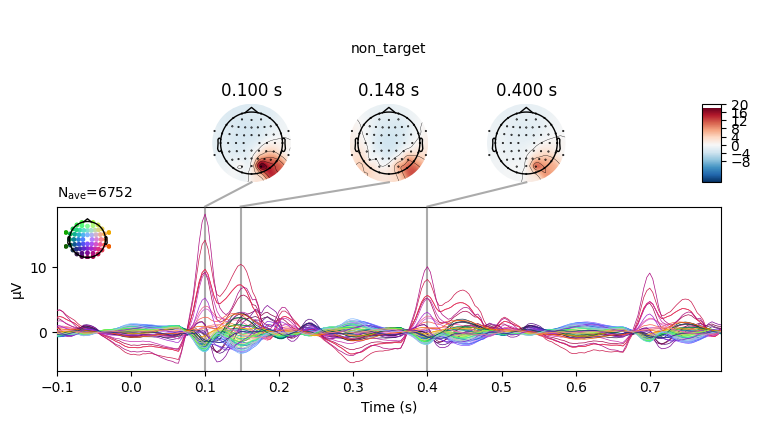







Subject_ID: 5
No projector specified for this dataset. Please consider the method self.add_proj.


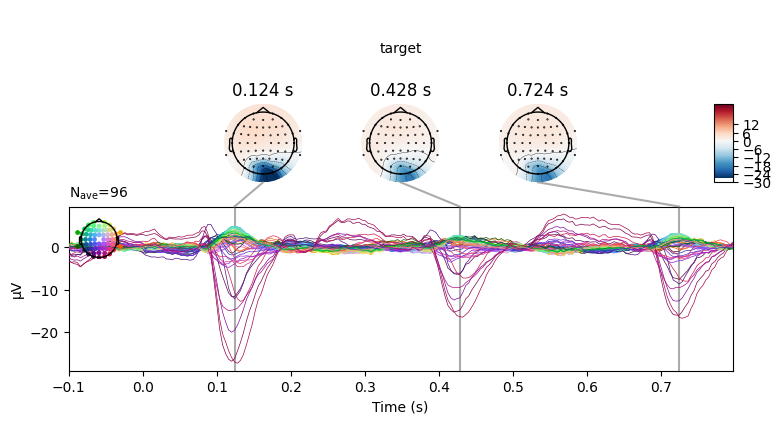

No projector specified for this dataset. Please consider the method self.add_proj.


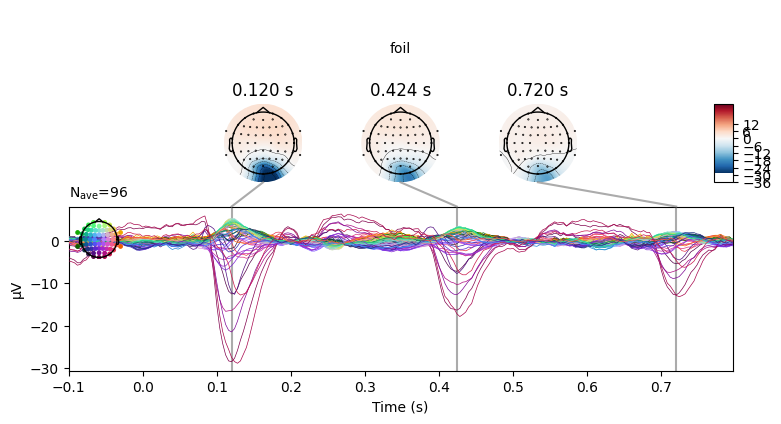

No projector specified for this dataset. Please consider the method self.add_proj.


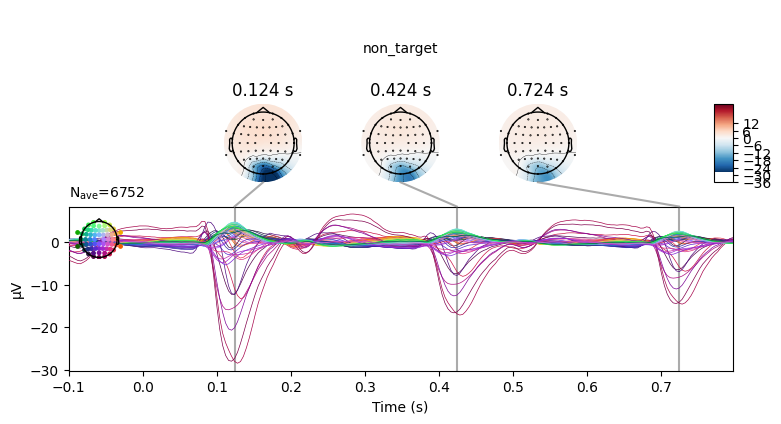







Subject_ID: 6
No projector specified for this dataset. Please consider the method self.add_proj.


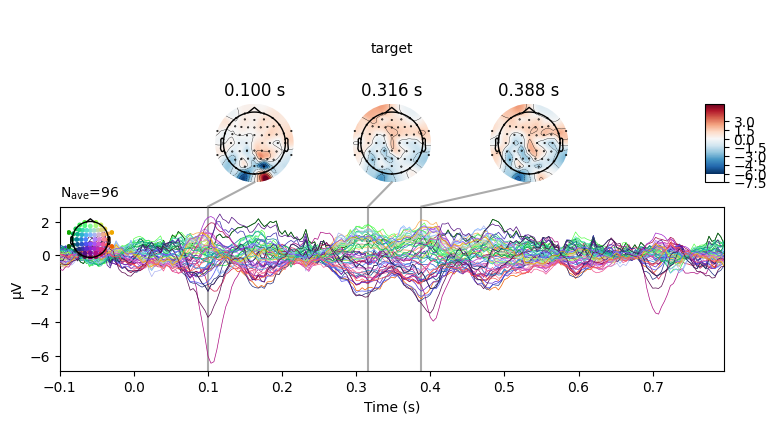

No projector specified for this dataset. Please consider the method self.add_proj.


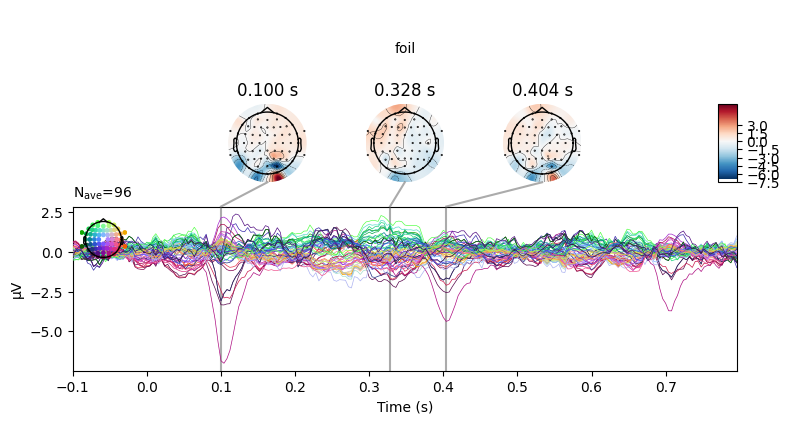

No projector specified for this dataset. Please consider the method self.add_proj.


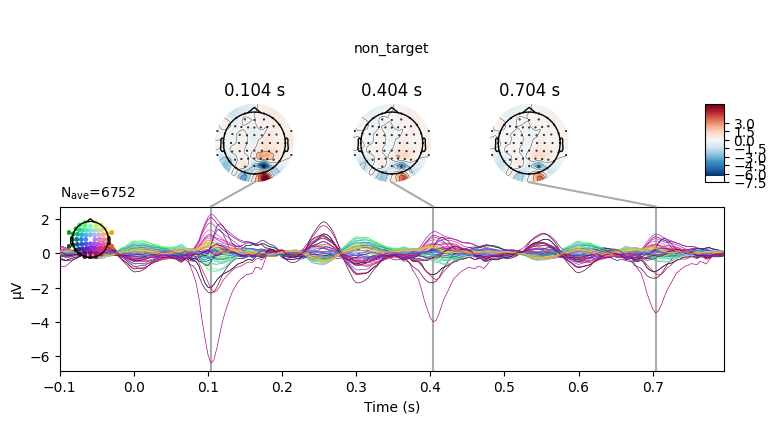







Subject_ID: 7
No projector specified for this dataset. Please consider the method self.add_proj.


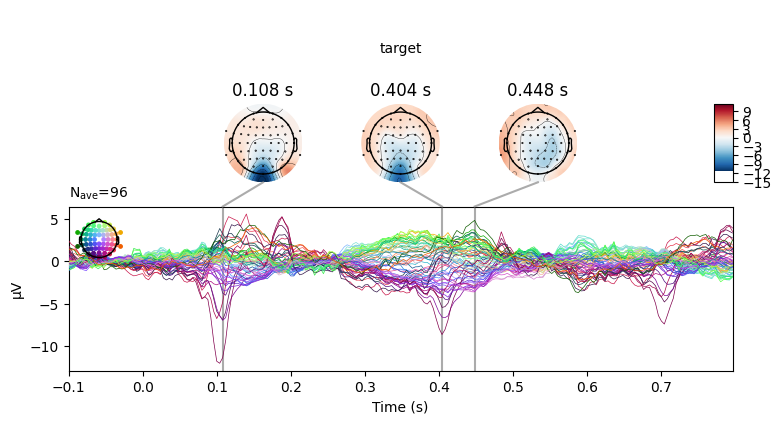

No projector specified for this dataset. Please consider the method self.add_proj.


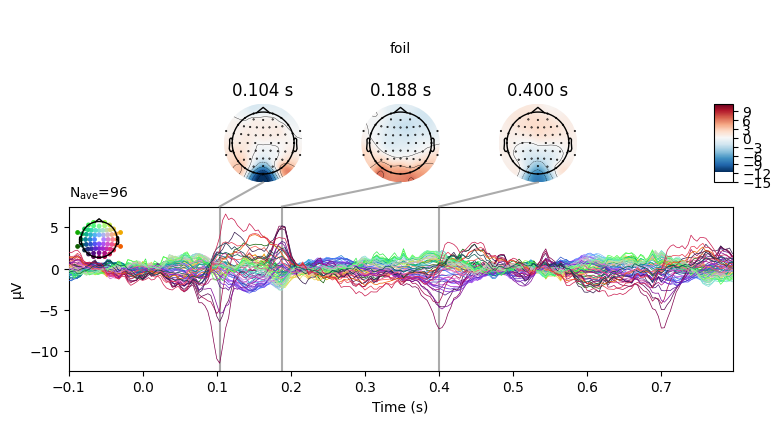

No projector specified for this dataset. Please consider the method self.add_proj.


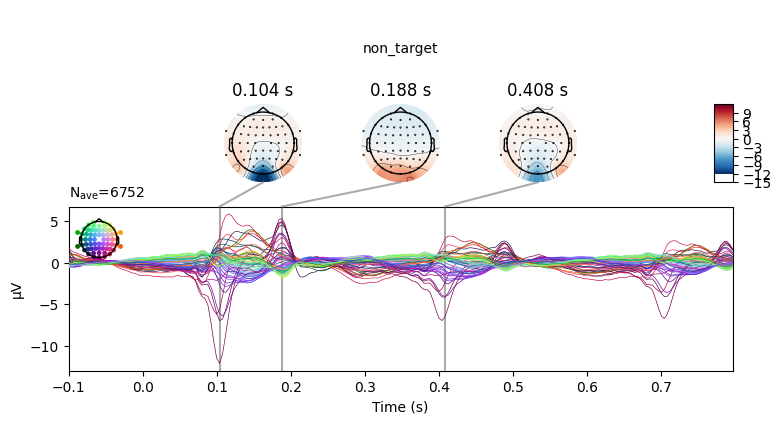







Subject_ID: 8
No projector specified for this dataset. Please consider the method self.add_proj.


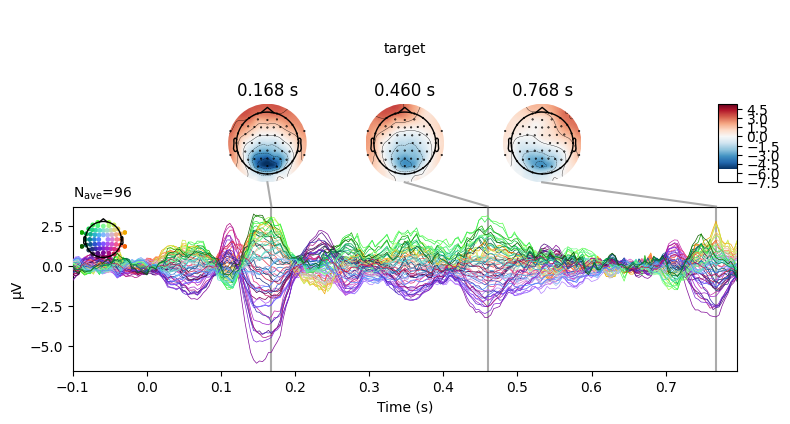

No projector specified for this dataset. Please consider the method self.add_proj.


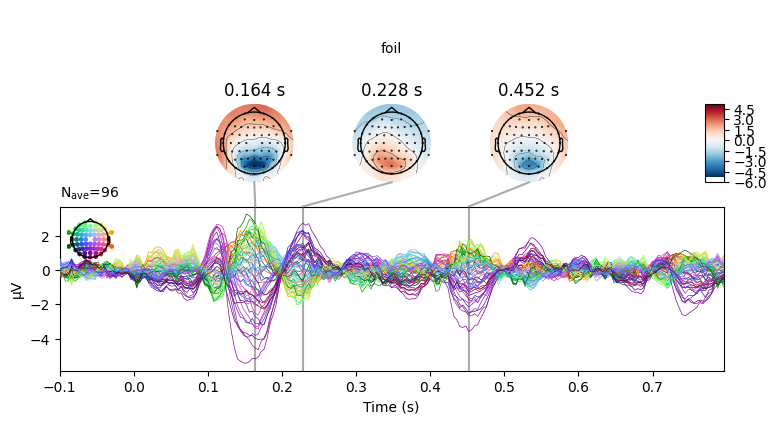

No projector specified for this dataset. Please consider the method self.add_proj.


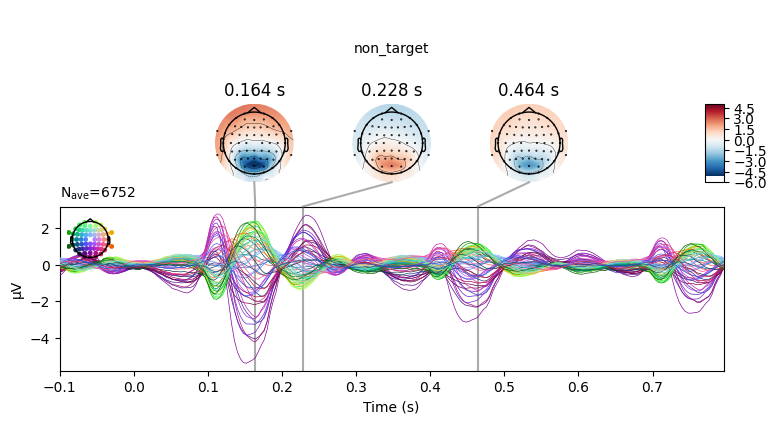







Subject_ID: 9
No projector specified for this dataset. Please consider the method self.add_proj.


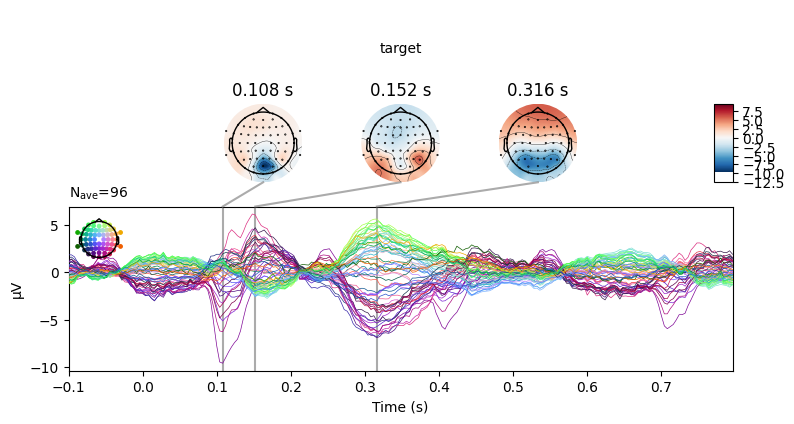

No projector specified for this dataset. Please consider the method self.add_proj.


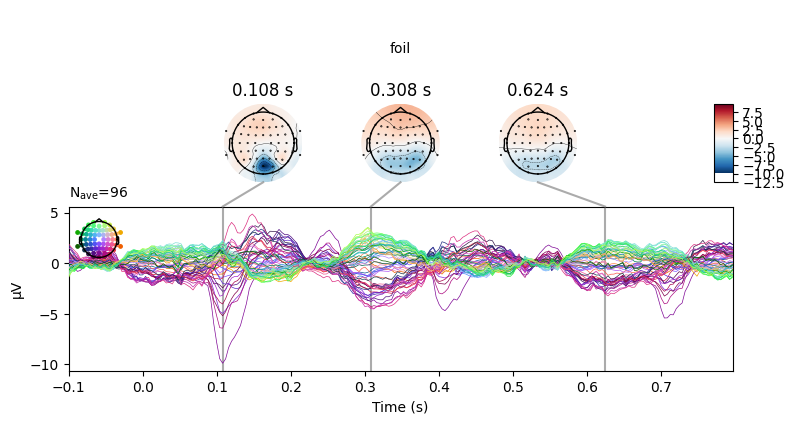

No projector specified for this dataset. Please consider the method self.add_proj.


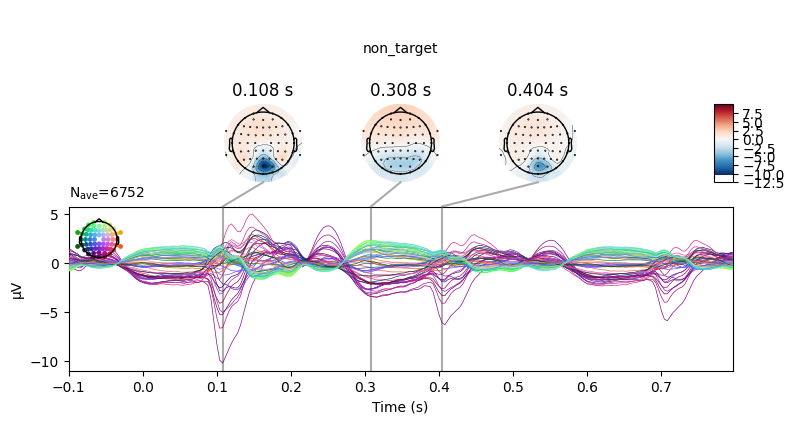







Subject_ID: 10
No projector specified for this dataset. Please consider the method self.add_proj.


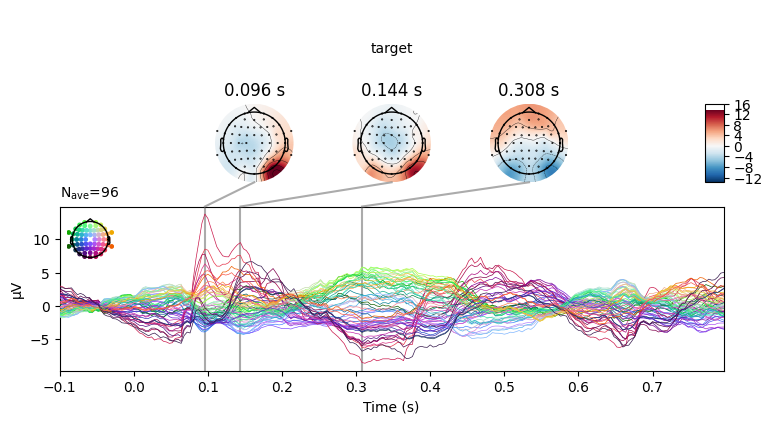

No projector specified for this dataset. Please consider the method self.add_proj.


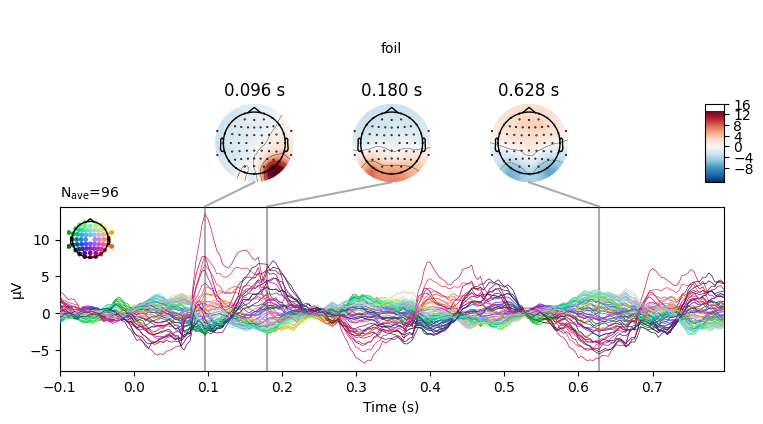

No projector specified for this dataset. Please consider the method self.add_proj.


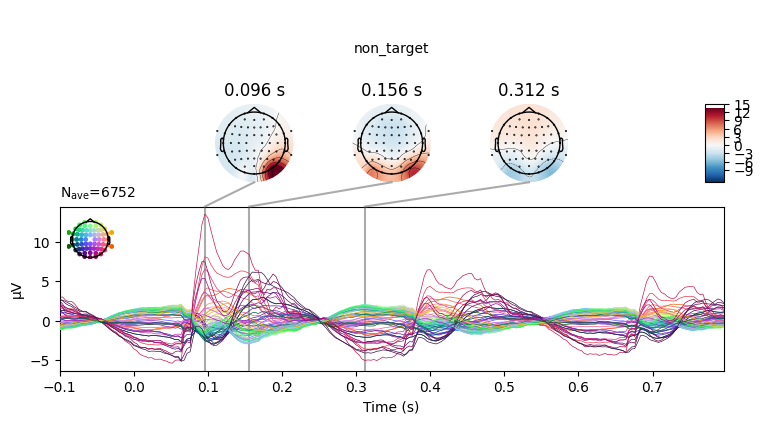







Subject_ID: 11
No projector specified for this dataset. Please consider the method self.add_proj.


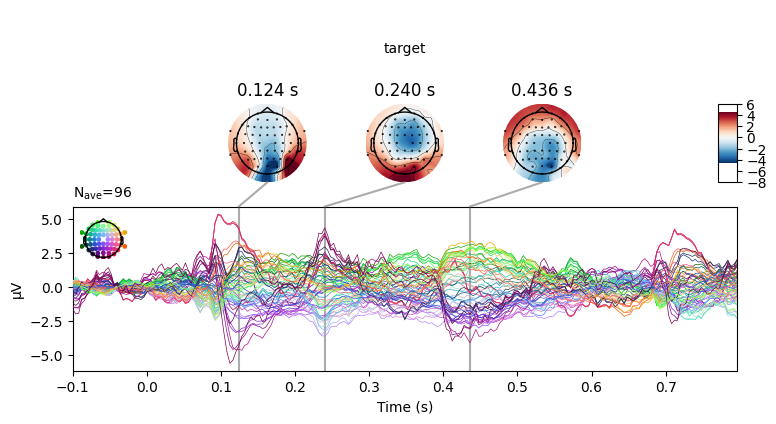

No projector specified for this dataset. Please consider the method self.add_proj.


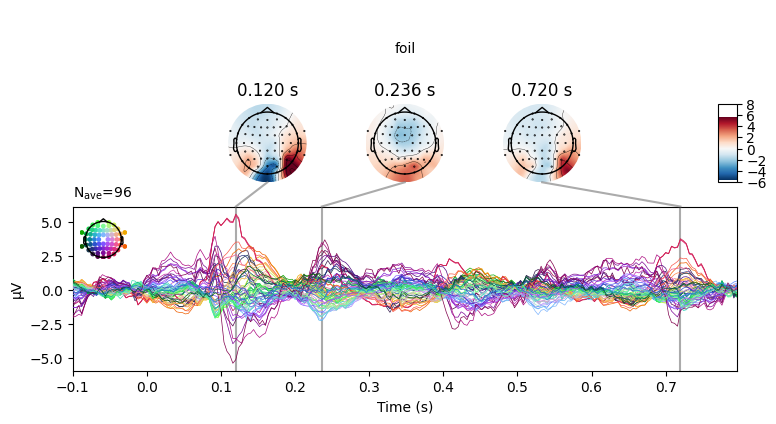

No projector specified for this dataset. Please consider the method self.add_proj.


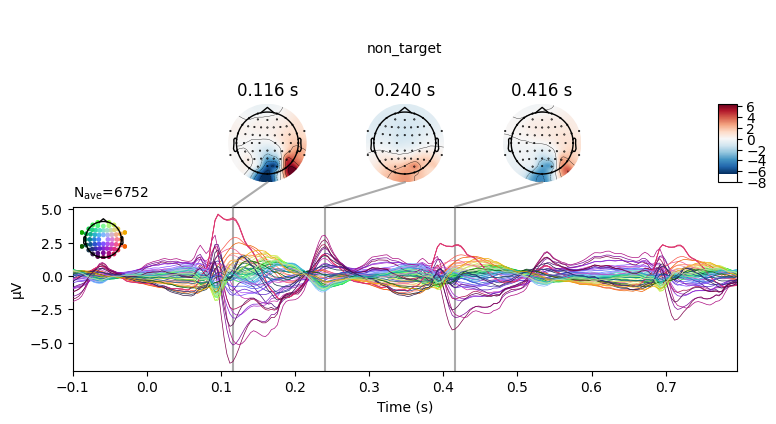







Subject_ID: 12
No projector specified for this dataset. Please consider the method self.add_proj.


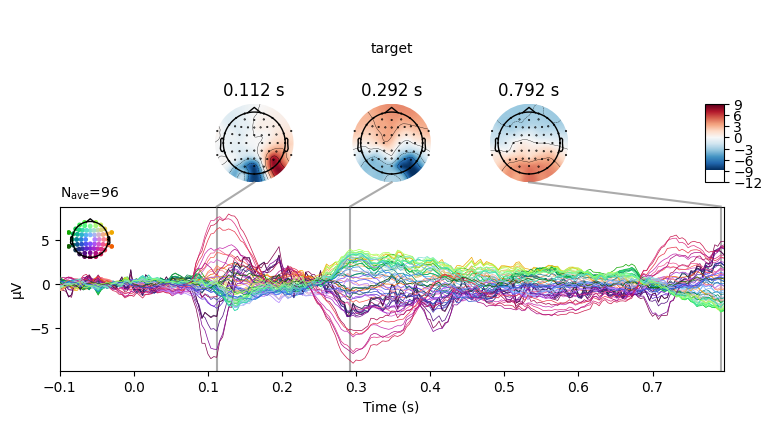

No projector specified for this dataset. Please consider the method self.add_proj.


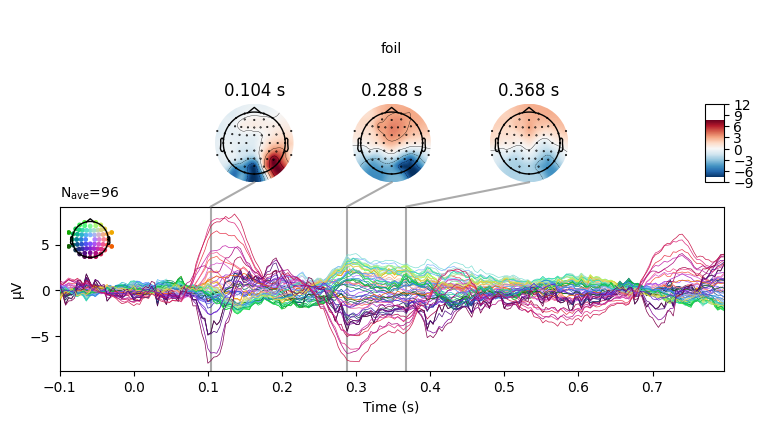

No projector specified for this dataset. Please consider the method self.add_proj.


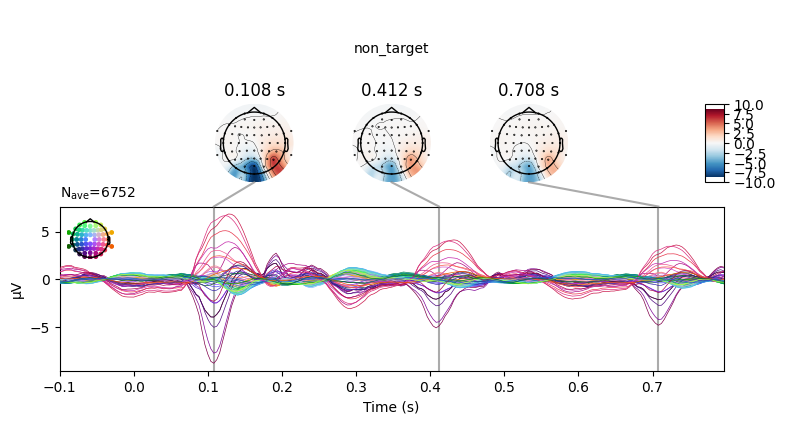







Subject_ID: 13
No projector specified for this dataset. Please consider the method self.add_proj.


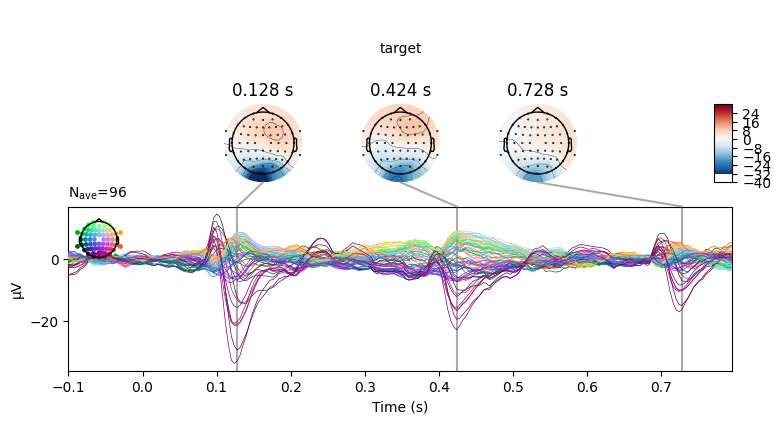

No projector specified for this dataset. Please consider the method self.add_proj.


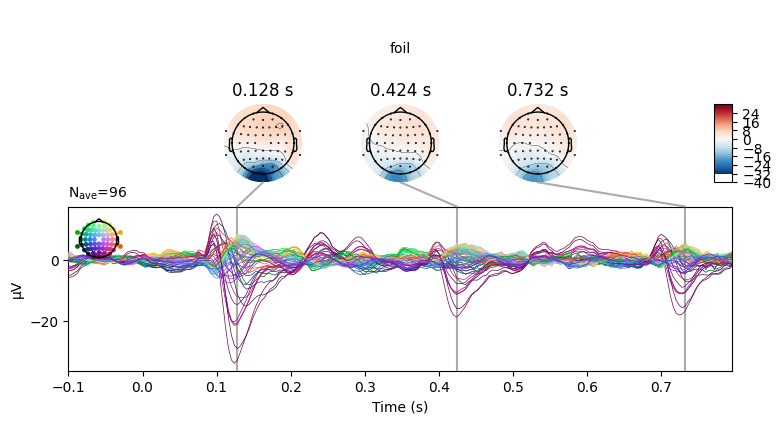

No projector specified for this dataset. Please consider the method self.add_proj.


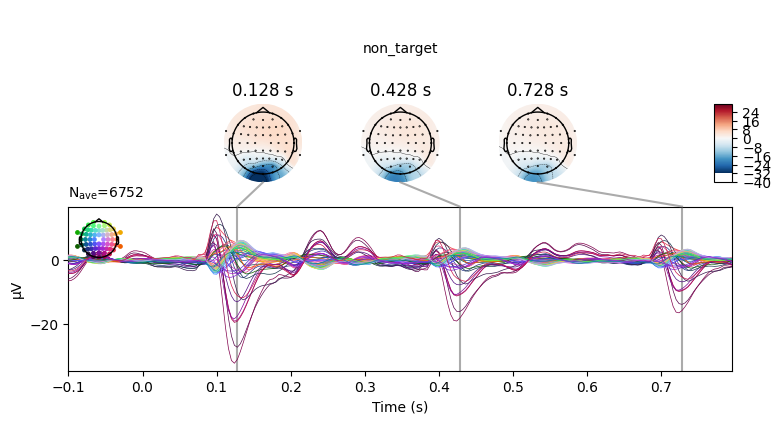







Subject_ID: 14
No projector specified for this dataset. Please consider the method self.add_proj.


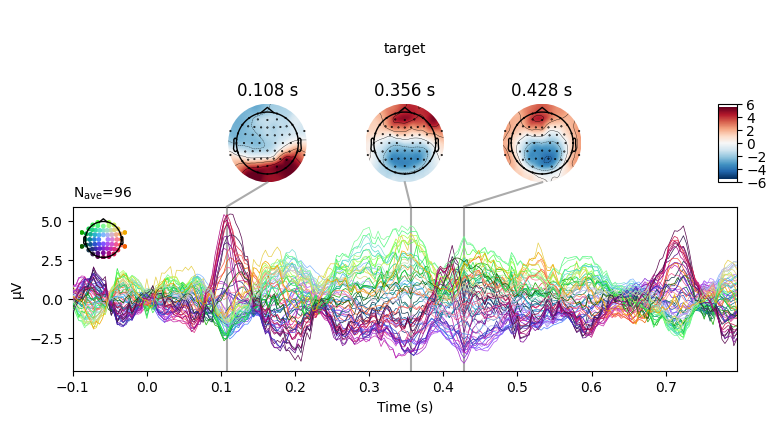

No projector specified for this dataset. Please consider the method self.add_proj.


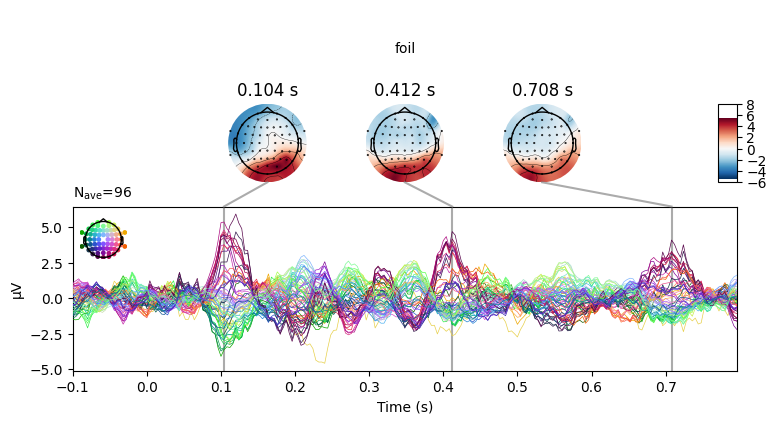

No projector specified for this dataset. Please consider the method self.add_proj.


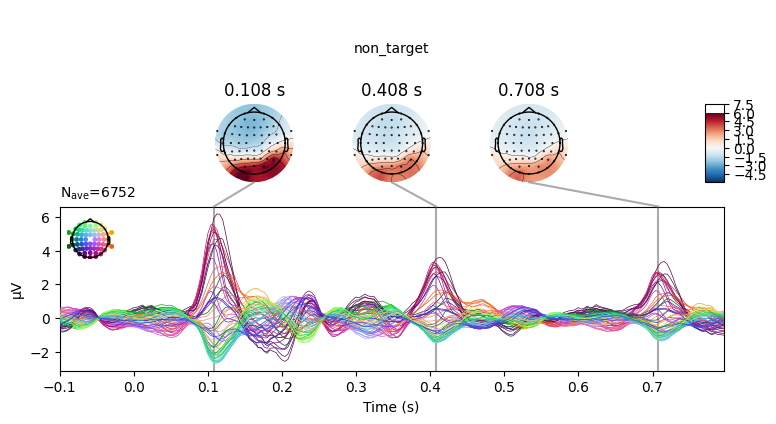







Subject_ID: 15
No projector specified for this dataset. Please consider the method self.add_proj.


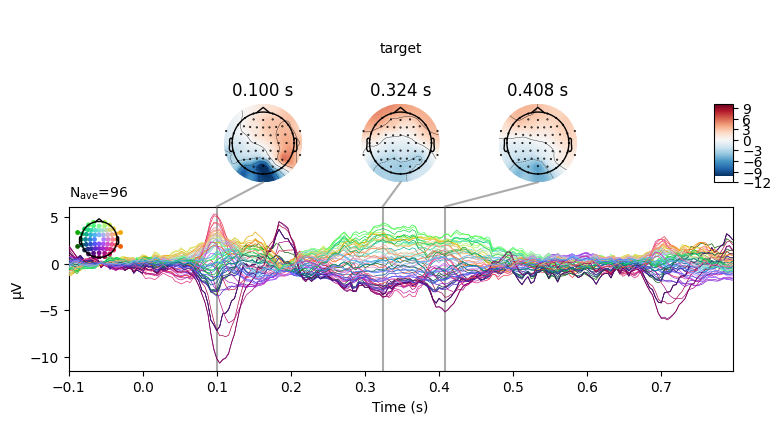

No projector specified for this dataset. Please consider the method self.add_proj.


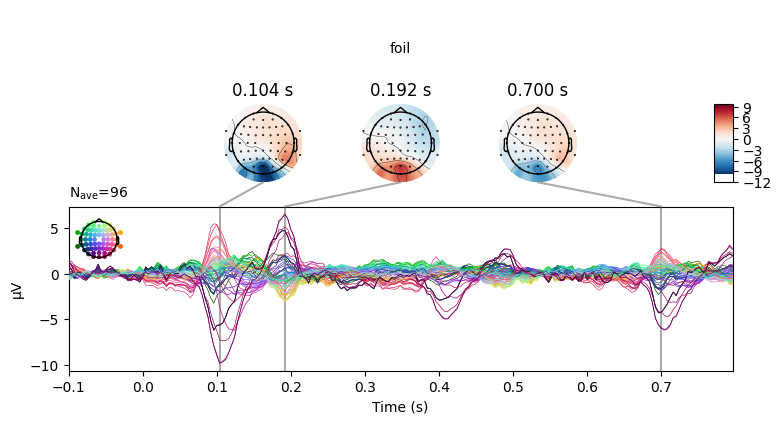

No projector specified for this dataset. Please consider the method self.add_proj.


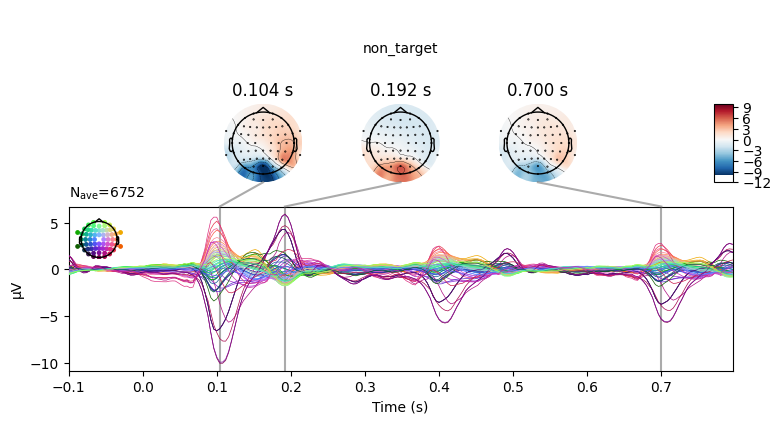







Subject_ID: 16
No projector specified for this dataset. Please consider the method self.add_proj.


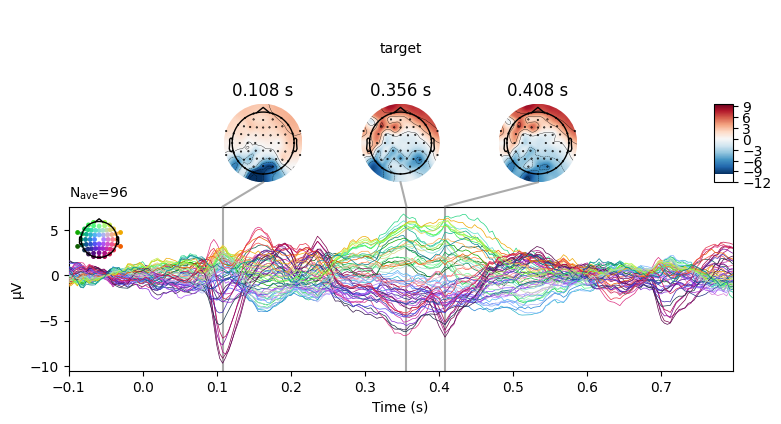

No projector specified for this dataset. Please consider the method self.add_proj.


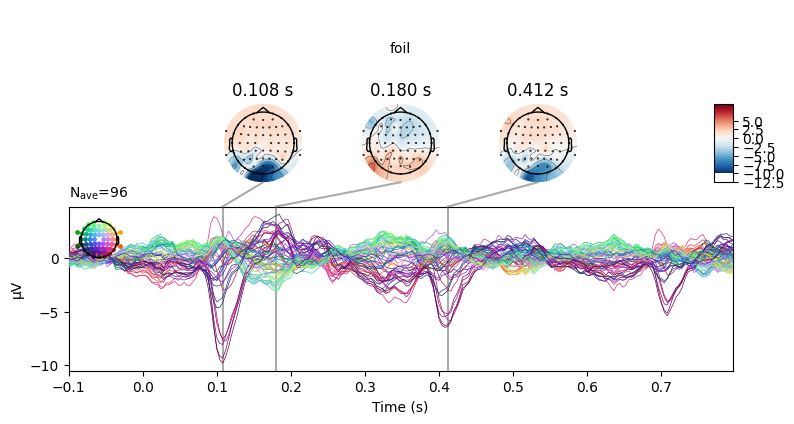

No projector specified for this dataset. Please consider the method self.add_proj.


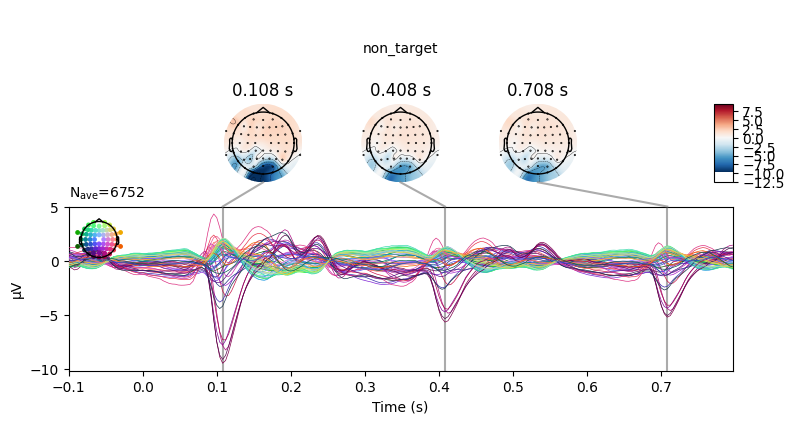







Subject_ID: 17
No projector specified for this dataset. Please consider the method self.add_proj.


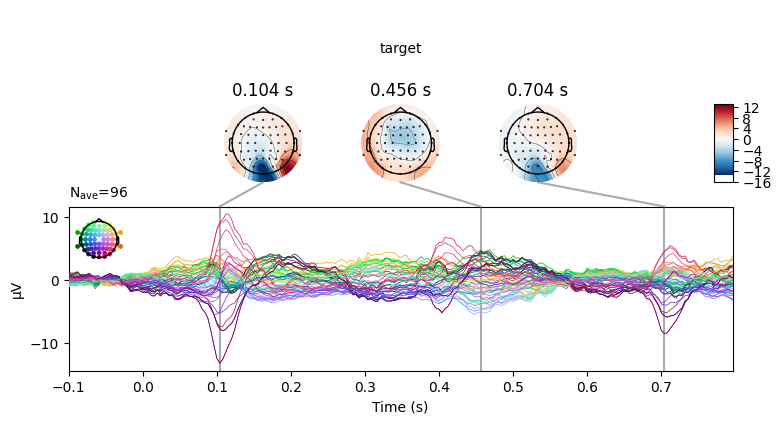

No projector specified for this dataset. Please consider the method self.add_proj.


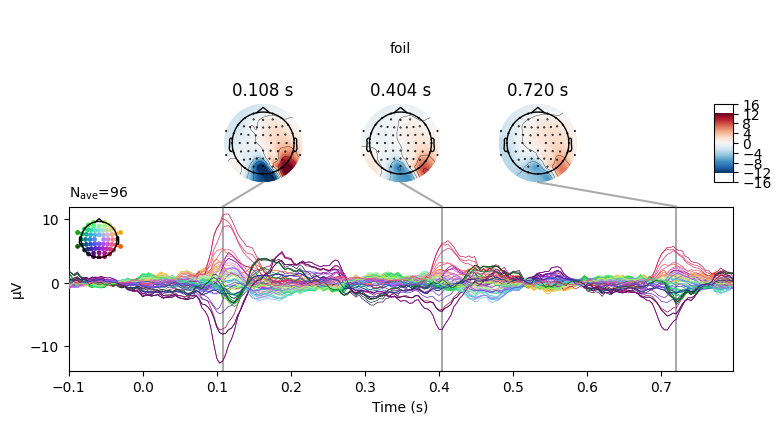

No projector specified for this dataset. Please consider the method self.add_proj.


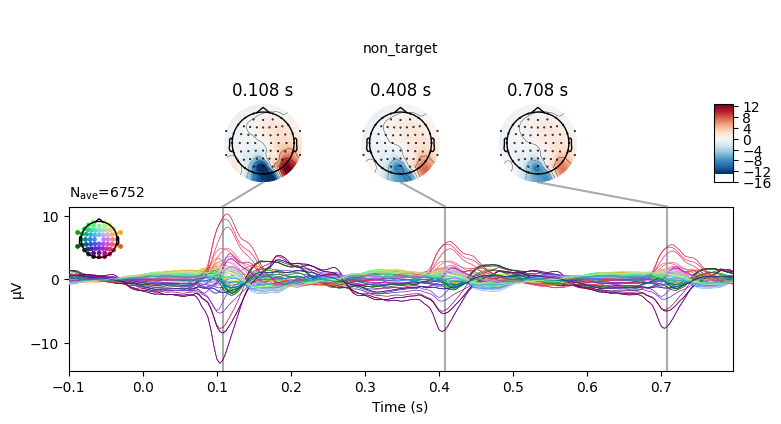







Subject_ID: 18
No projector specified for this dataset. Please consider the method self.add_proj.


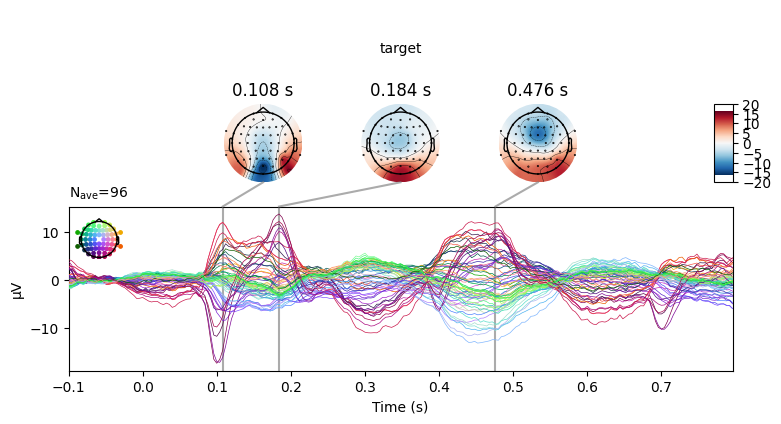

No projector specified for this dataset. Please consider the method self.add_proj.


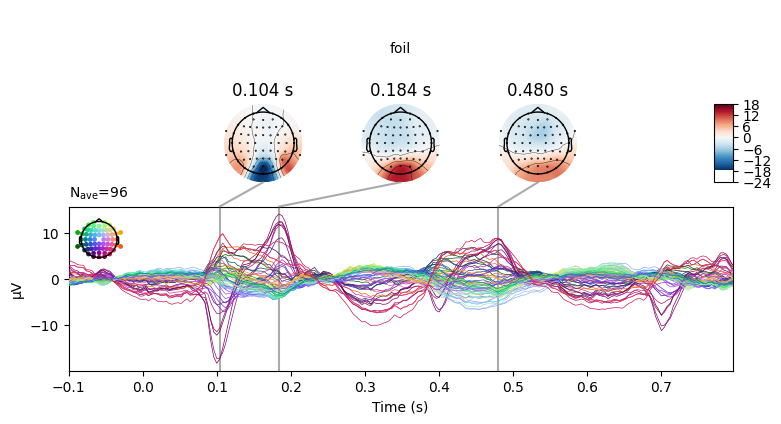

No projector specified for this dataset. Please consider the method self.add_proj.


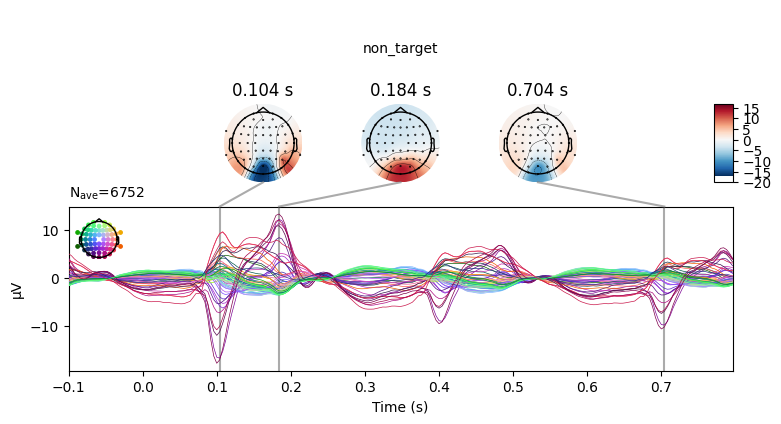







Subject_ID: 19
No projector specified for this dataset. Please consider the method self.add_proj.


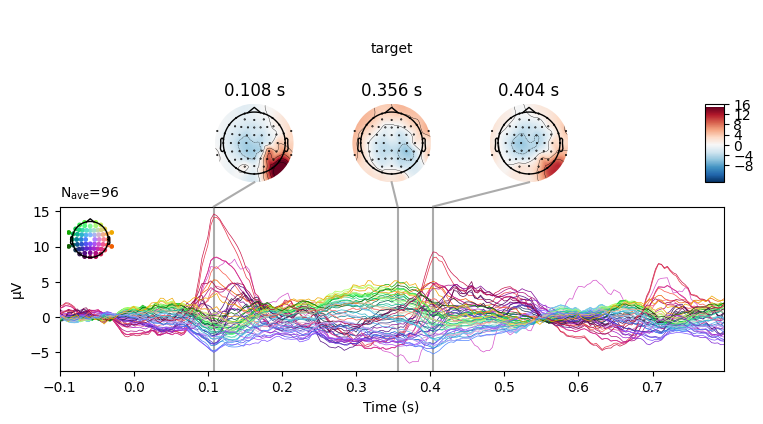

No projector specified for this dataset. Please consider the method self.add_proj.


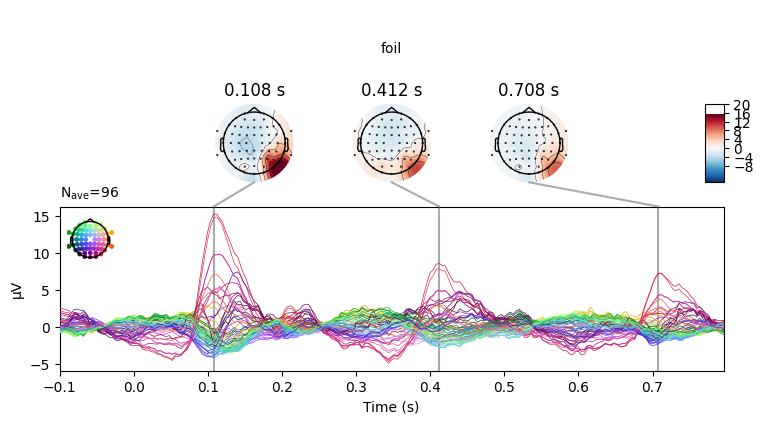

No projector specified for this dataset. Please consider the method self.add_proj.


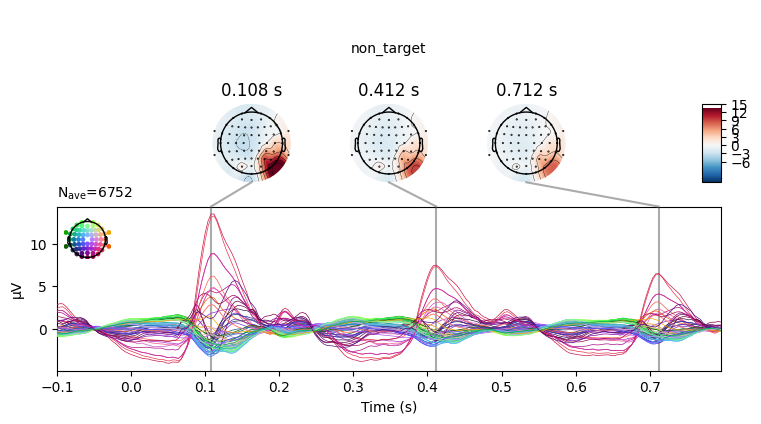







Subject_ID: 20
No projector specified for this dataset. Please consider the method self.add_proj.


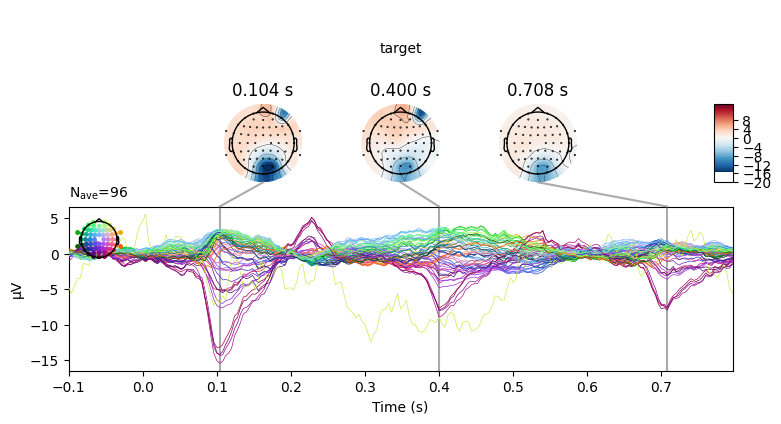

No projector specified for this dataset. Please consider the method self.add_proj.


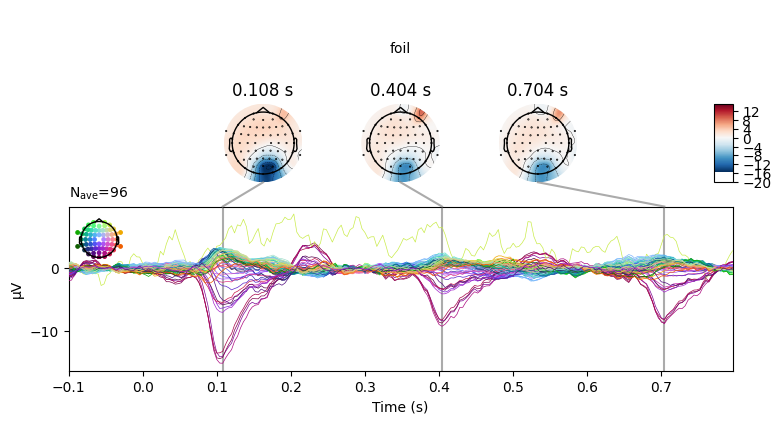

No projector specified for this dataset. Please consider the method self.add_proj.


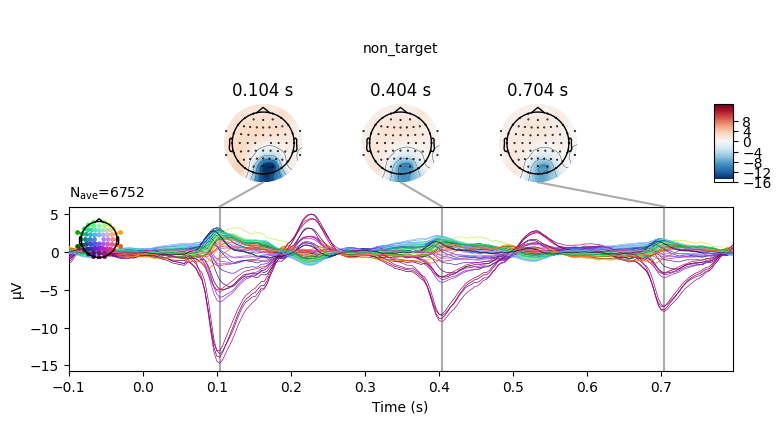

In [ ]:
for id,t,f,n in zip(subject_ids, ica_evoked_all['target'], ica_evoked_all['foil'], ica_evoked_all['non_target']):
  print('Subject_ID: '+str(id))
  individual_ERP(t,f,n)
  print('\n'*5)

###Average

Computing averages and contrast of target and foil ERPs


No projector specified for this dataset. Please consider the method self.add_proj.


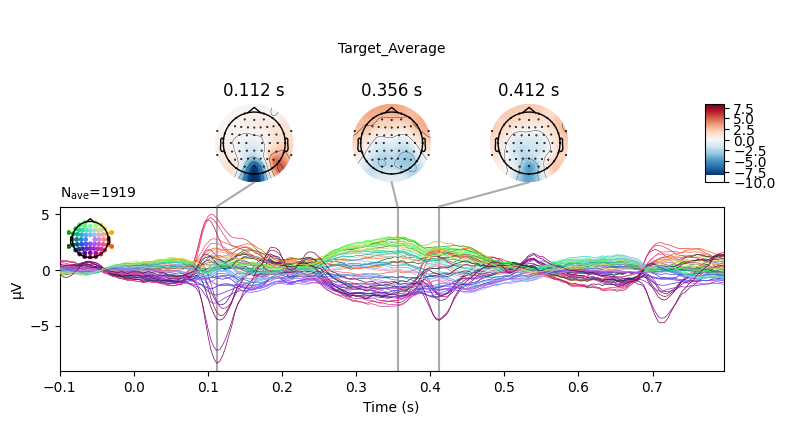

No projector specified for this dataset. Please consider the method self.add_proj.


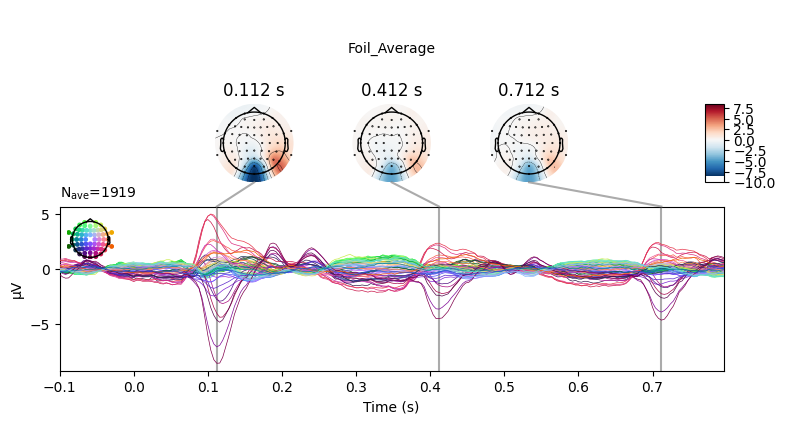

No projector specified for this dataset. Please consider the method self.add_proj.


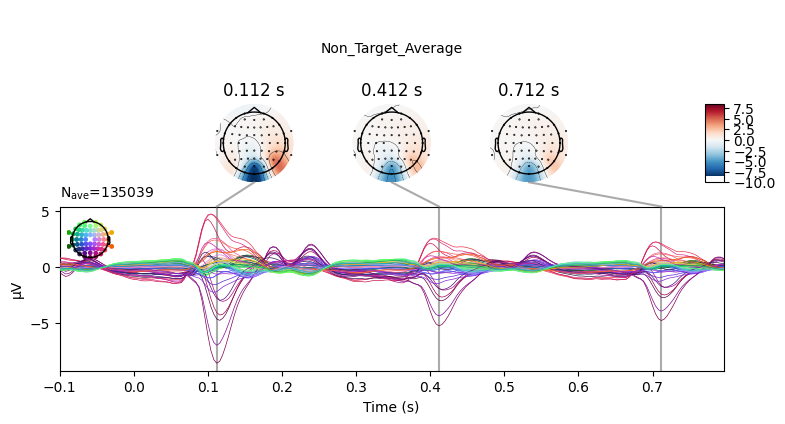



No projector specified for this dataset. Please consider the method self.add_proj.


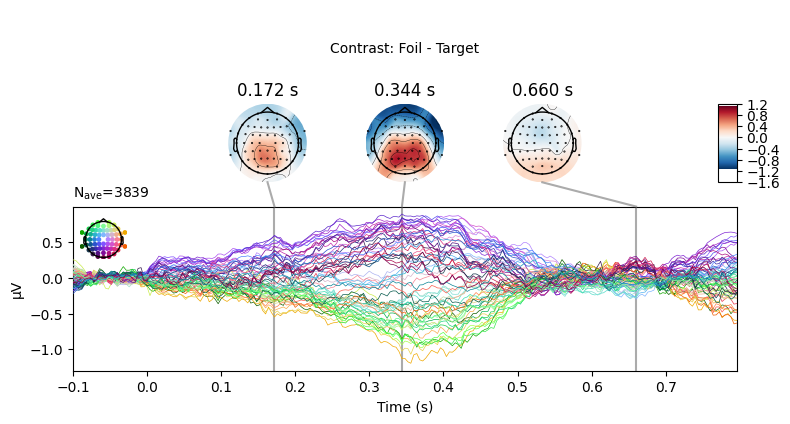

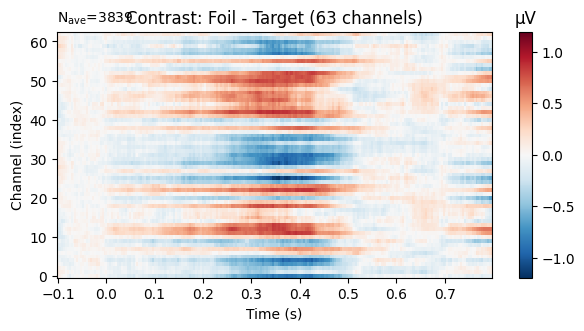



No projector specified for this dataset. Please consider the method self.add_proj.


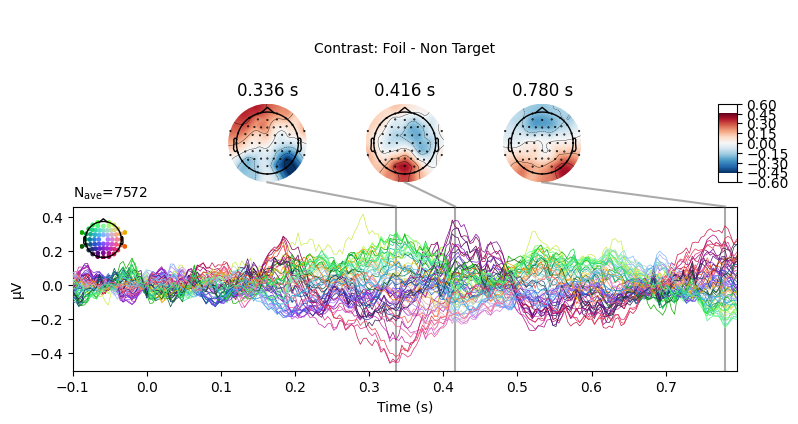

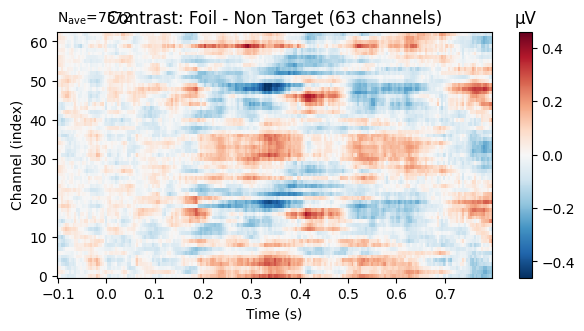



No projector specified for this dataset. Please consider the method self.add_proj.


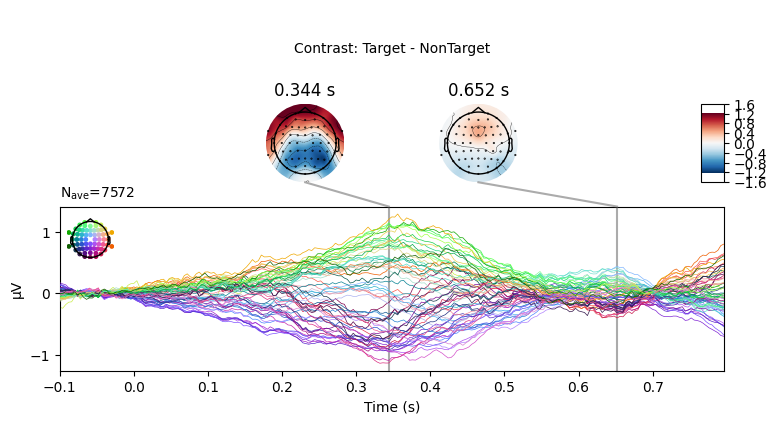

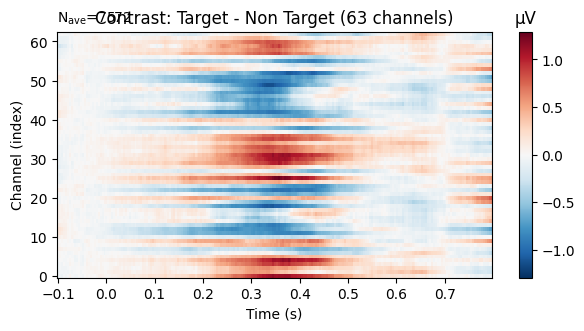

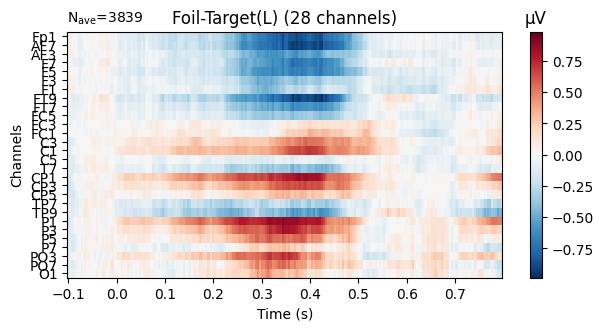

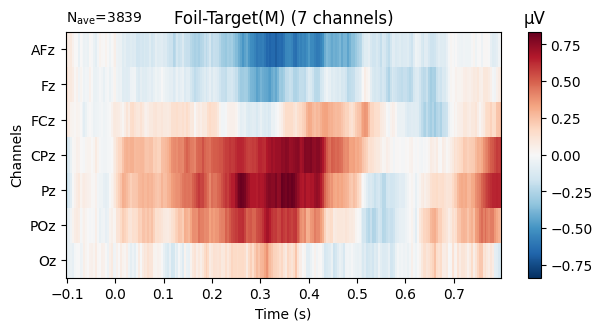

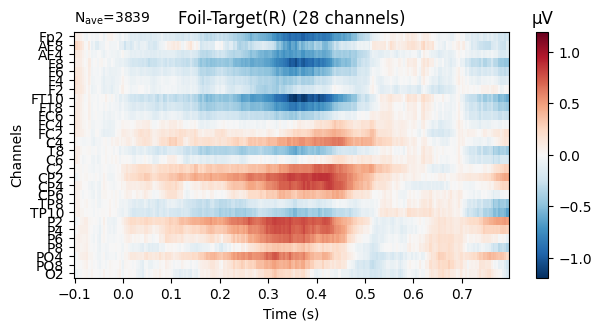



Computing time frequency power average and contrast of target and foil epochs
No baseline correction applied
No baseline correction applied


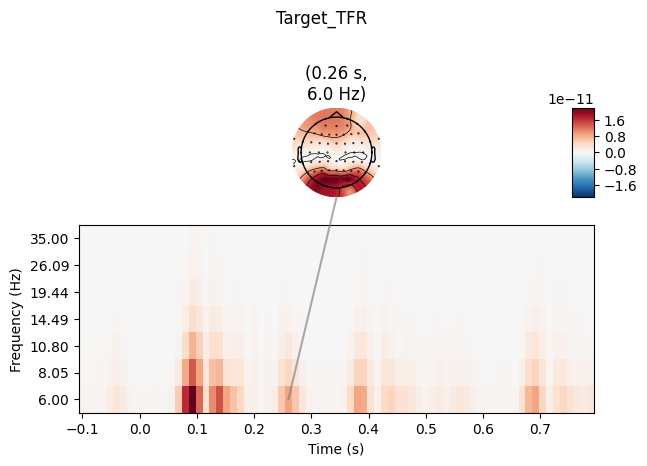



No baseline correction applied
No baseline correction applied


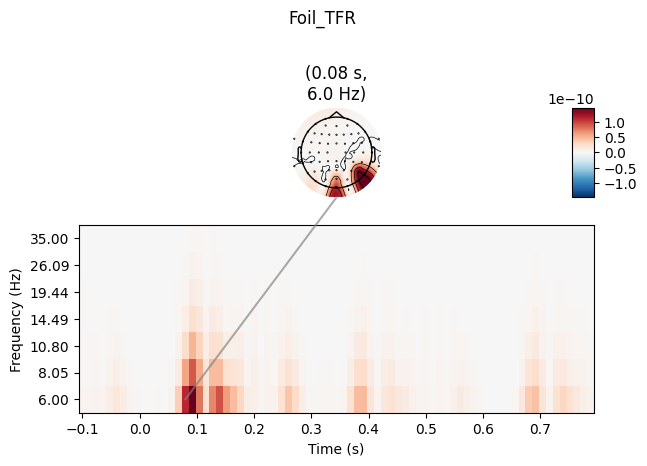



Applying baseline correction (mode: mean)
No baseline correction applied
No baseline correction applied


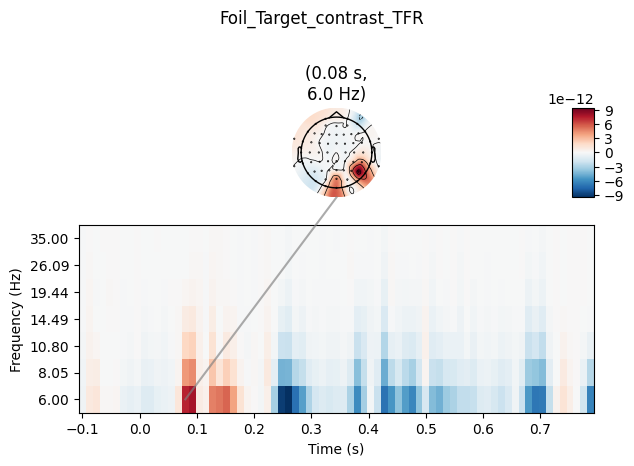

In [ ]:
ERP_TFR_contrast(ica_evoked_all, n_cycles=0.5)

Computing averages and contrast of target and foil ERPs


No projector specified for this dataset. Please consider the method self.add_proj.


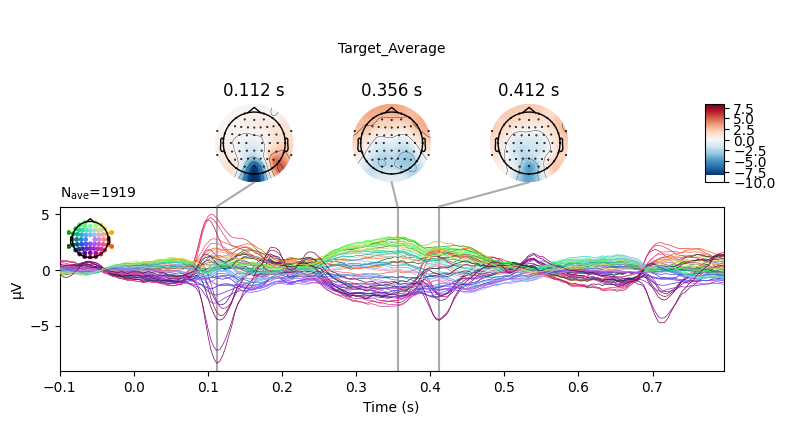

No projector specified for this dataset. Please consider the method self.add_proj.


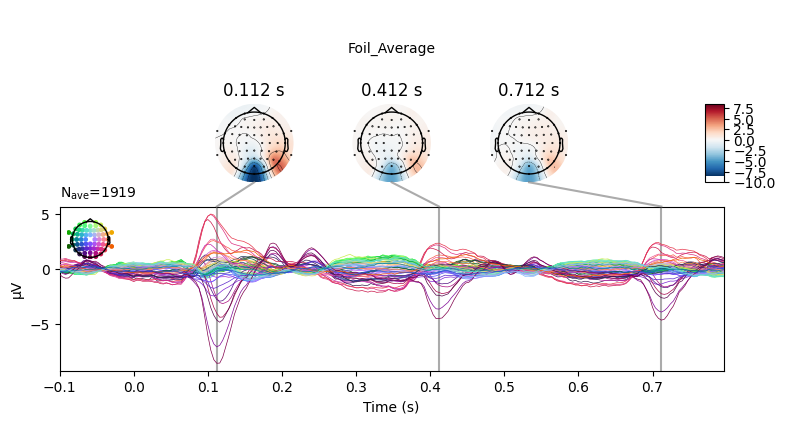

No projector specified for this dataset. Please consider the method self.add_proj.


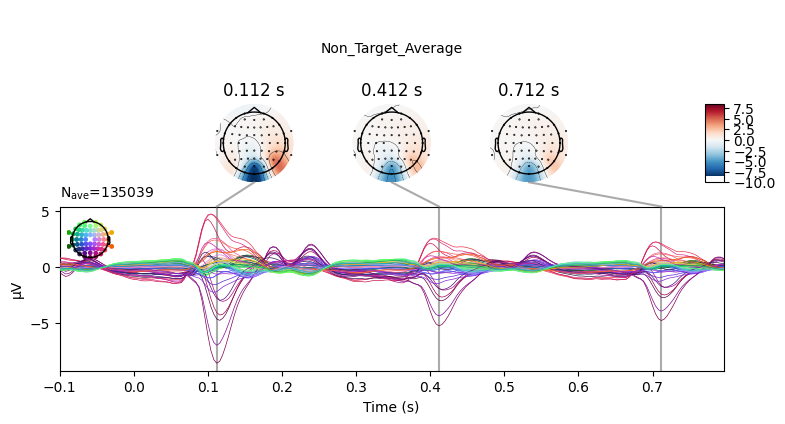



No projector specified for this dataset. Please consider the method self.add_proj.


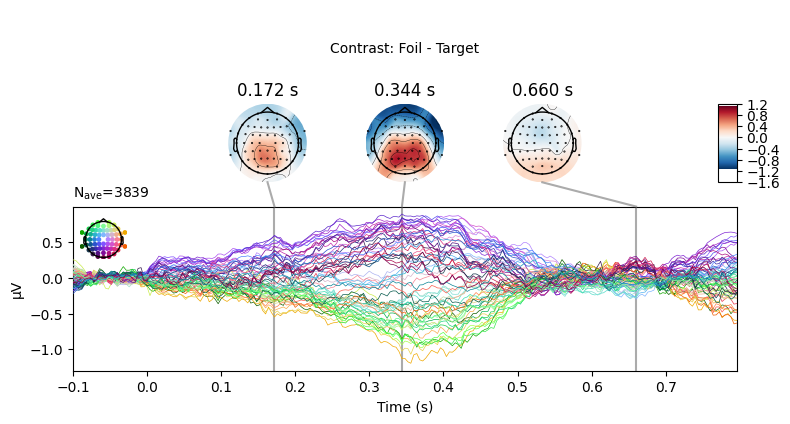

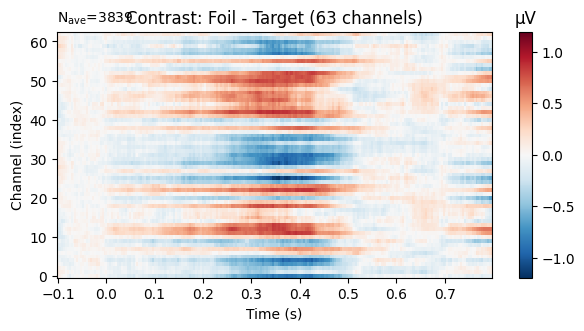



No projector specified for this dataset. Please consider the method self.add_proj.


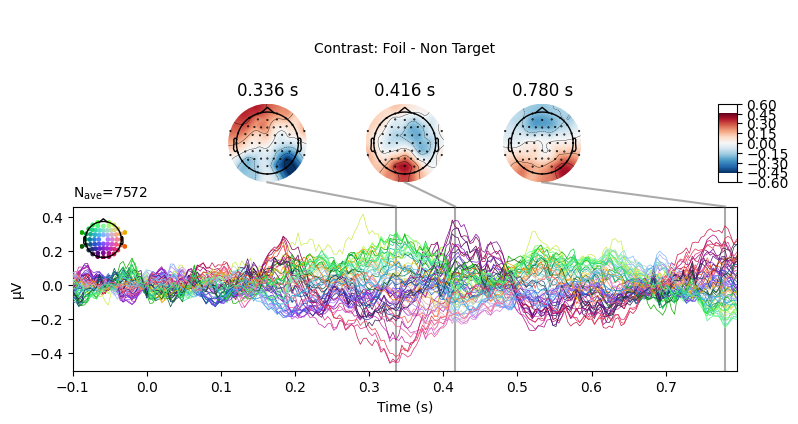

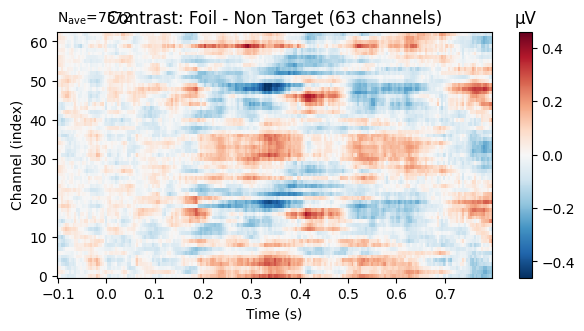



No projector specified for this dataset. Please consider the method self.add_proj.


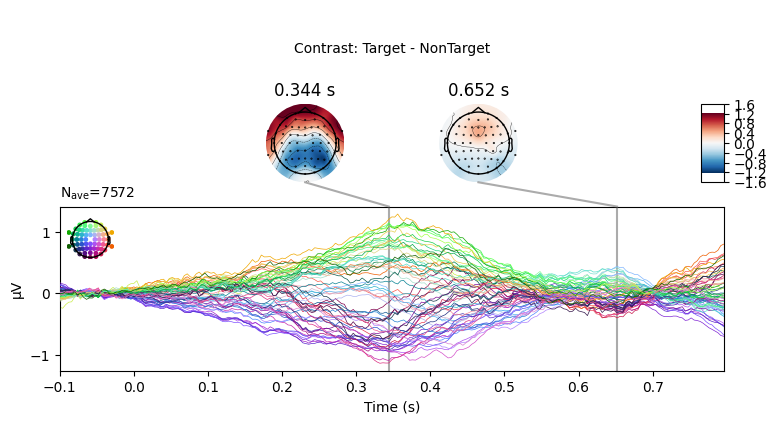

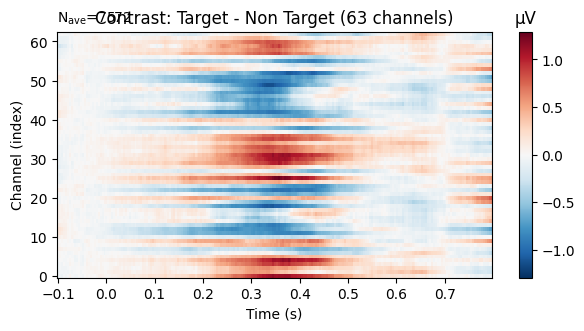

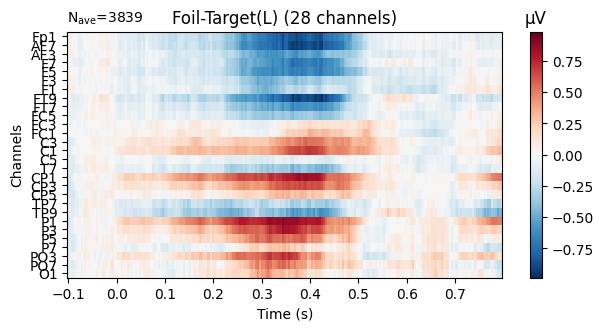

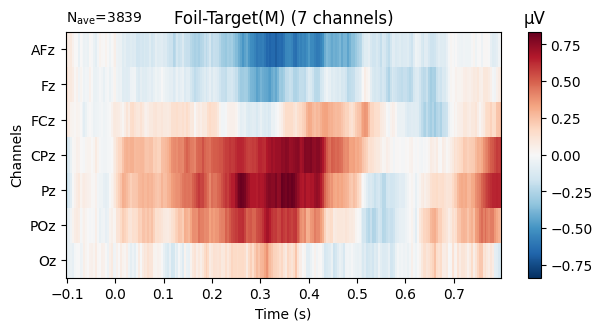

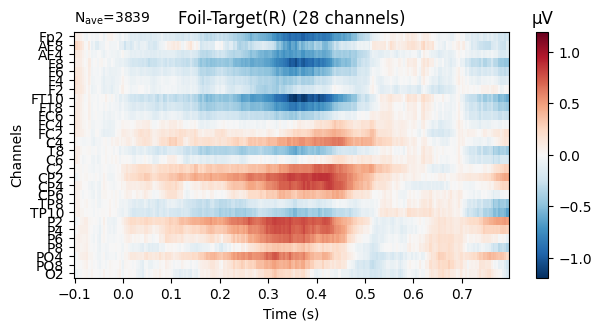



Computing time frequency power average and contrast of target and foil epochs
No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied


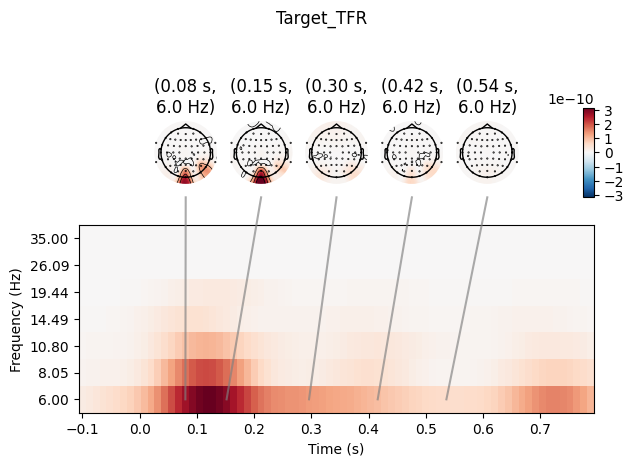



No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied


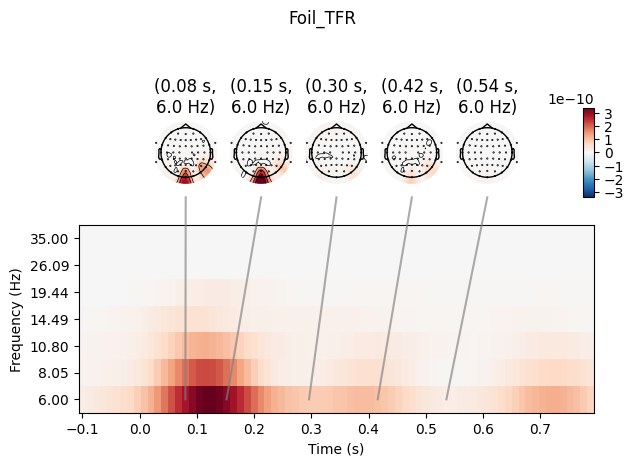



Applying baseline correction (mode: mean)
No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied
No baseline correction applied


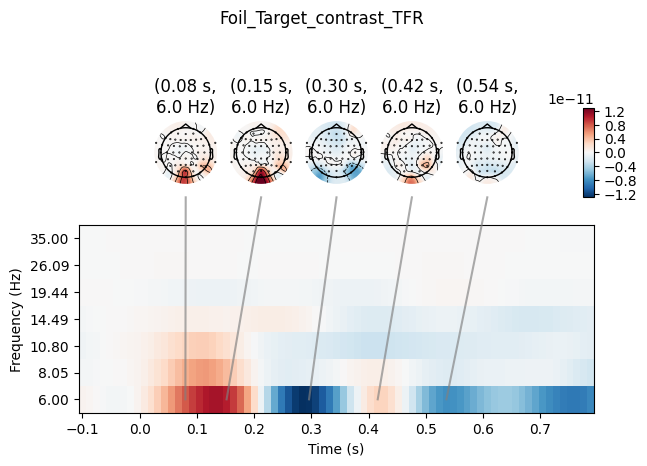

In [ ]:
timefreqs=[(0.08, 6), (0.295, 6), (0.15, 6), (0.42, 6), (0.54, 6)]
ERP_TFR_contrast(ica_evoked_all, timefreqs=timefreqs,n_cycles=None)

#Inferences


*   Proposed hypothesis of there being differential activity in the dorsal and ventral visual stream seems to be absent based on qualitative analysis of sensors positioned around the occipital, parietal and temporal lobes.
*   There exists differential activity between target and foil stimuli activity where in the contrast between foil and target shows relative inhibition in the frontal areas and excitation in the occipital regions.
*   No qualitative evidence for lateralisation.
*   Literature suggests right frontal cortex lateralisation in decision making tasks - [The architecture of functional lateralisation and its relationship to callosal connectivity in the human brain](https://www.nature.com/articles/s41467-019-09344-1#Sec2) ![image](https://media.springernature.com/lw685/springer-static/image/art%3A10.1038%2Fs41467-019-09344-1/MediaObjects/41467_2019_9344_Fig2_HTML.png?as=webp)

